Saving image3.jpg to image3.jpg
Encrypted channel images saved successfully!
Bitstream files saved successfully for NIST analysis!
Encryption Time: 1.420610 seconds
Decryption successful!


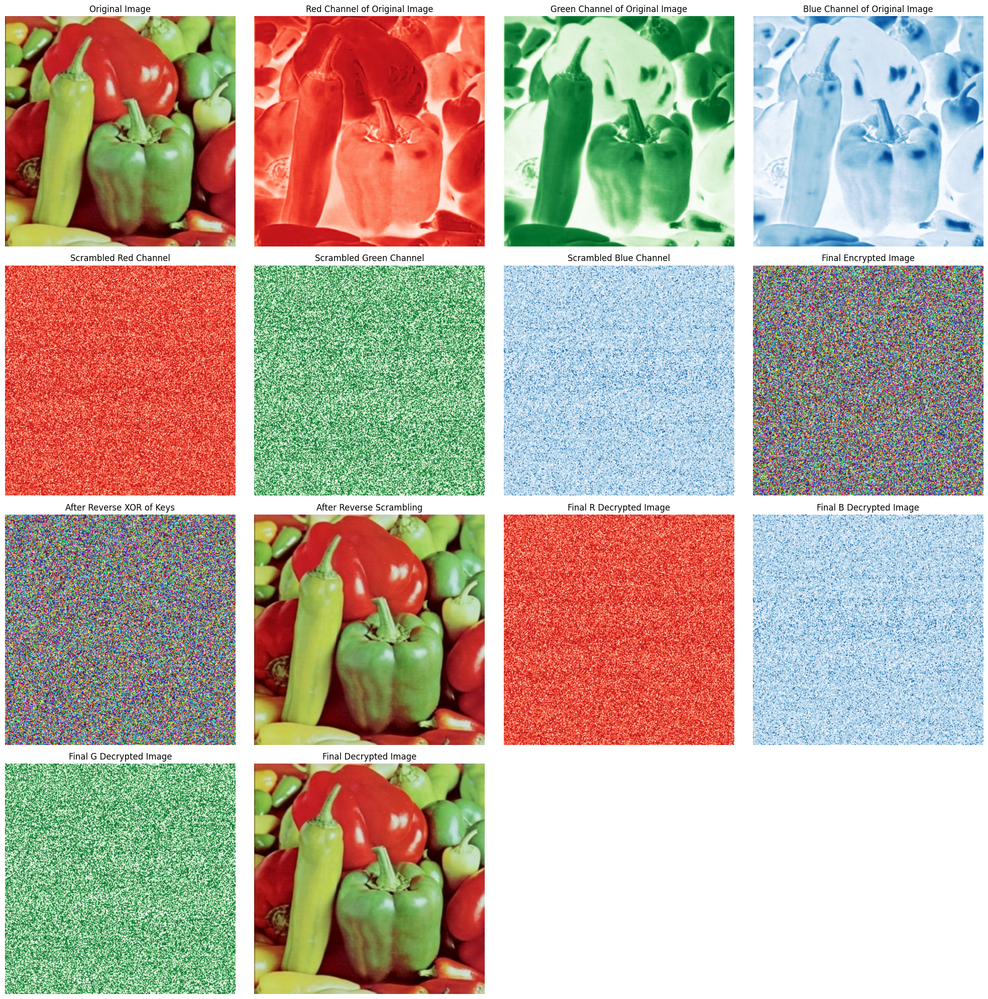

Encryption & Decryption Complete.


In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import struct
import time
import os
from google.colab import files

# Step 1: Upload Image
uploaded = files.upload()
for filename in uploaded.keys():
    img = cv2.imread(filename)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

# Ensure if the image is square
h, w, _ = img.shape
N = min(h, w)
img = cv2.resize(img, (N, N))

# Split into R, G, B channels
R, G, B = cv2.split(img)

# Encryption Time Calculation
start_time = time.time()

# ENCRYPTION

# Step 2: 2D Standard Map Scrambling
def standard_map(N, K=0.5, iterations=100):
    theta, p = np.meshgrid(np.linspace(0, 2 * np.pi, N), np.linspace(0, 2 * np.pi, N))

    for _ in range(iterations):
        p = (p + K * np.sin(theta)) % (2 * np.pi)
        theta = (theta + p) % (2 * np.pi)

    sorted_indices = np.argsort(theta.ravel())
    return sorted_indices.reshape(N, N)

def standard_scramble(channel, N):
    indices = standard_map(N).flatten()
    scrambled = channel.flatten()[indices].reshape(N, N)
    return scrambled, indices.reshape(N, N)

R_scrambled, R_map = standard_scramble(R, N)
G_scrambled, G_map = standard_scramble(G, N)
B_scrambled, B_map = standard_scramble(B, N)


# Step 3: Generate First Encryption Key
def logistic_sine_map(n, x0=0.3, y0=0.3, a=0.9):
    x, y = x0, y0
    x_seq, y_seq = [], []
    for _ in range(n):
        x = np.sin(np.pi * a * (y + 3) * x * (1 - x))
        y = np.sin(np.pi * a * (x + 4) * y * (1 - y))
        x_seq.append(x)
        y_seq.append(y)
    return np.array(x_seq), np.array(y_seq)

def linear_congruential_generator(n, L1_0=3538644446, aL1=27, c1=0, m1=2**52-1,
                                  L2_0=2700000, aL2=37, c2=1, m2=2**32-1):
    L1, L2 = L1_0, L2_0
    sequence_L1, sequence_L2 = [], []

    for _ in range(n):
        L1 = (aL1 * L1 + c1) % m1
        L2 = (aL2 * L2 + c2) % m2
        sequence_L1.append(L1)
        sequence_L2.append(L2)

    return np.array(sequence_L1, dtype=np.uint64), np.array(sequence_L2, dtype=np.uint64)  # Use uint64 to prevent overflow


N_total = N * N

L1_seq, L2_seq = linear_congruential_generator(N_total)

L1_seq = (L1_seq % (2**52)).astype(np.uint64)
L2_seq = (L2_seq % (2**32)).astype(np.uint32)

x_seq, y_seq = logistic_sine_map(N_total)
x_seq_bits = np.array([struct.unpack('Q', struct.pack('d', x))[0] for x in x_seq], dtype=np.uint64)
y_seq_bits = np.array([struct.unpack('Q', struct.pack('d', y))[0] for y in y_seq], dtype=np.uint64)


a_bits = np.array(int(0.9 * (2**44)) & ((1 << 44) - 1), dtype=np.uint64)


# Step 4: Construct the 256×256-bit Encryption Key
key_matrix = np.zeros(N_total, dtype=np.uint64)

for i in range(N_total):
    key_matrix[i] = ((x_seq_bits[i] & ((1 << 64) - 1)) << (64 + 44)) | \
                    ((y_seq_bits[i] & ((1 << 64) - 1)) << 44) | \
                    (a_bits << 32) | \
                    ((L1_seq[i] & ((1 << 52) - 1)) << 32) | \
                    (L2_seq[i] & ((1 << 32) - 1))

key_matrix = (key_matrix % 256).astype(np.uint8).reshape(N, N)

def xor_bitwise_submatrices(channel, key):
    channel_bits = np.unpackbits(channel.astype(np.uint8), axis=1)
    key_bits = np.unpackbits(key.astype(np.uint8), axis=1)

    xor_result = np.bitwise_xor(channel_bits, key_bits)

    return np.packbits(xor_result, axis=1).reshape(channel.shape).astype(np.uint8)

R_encrypted = xor_bitwise_submatrices(R_scrambled, key_matrix)
G_encrypted = xor_bitwise_submatrices(G_scrambled, key_matrix)
B_encrypted = xor_bitwise_submatrices(B_scrambled, key_matrix)

# Step 5: Generate Second Encryption Key
def lorenz_key_generator(n_bytes, x0=0.1, y0=0.1, z0=0.1, sigma=10, rho=28, beta=8/3, dt=0.01, warmup=1000):
    x, y, z = x0, y0, z0
    key_bytes = []

    # Warm-up
    for _ in range(warmup):
        dx = sigma * (y - x)
        dy = x * (rho - z) - y
        dz = x * y - beta * z
        x += dx * dt
        y += dy * dt
        z += dz * dt
    # Generate
    while len(key_bytes) < n_bytes:
        dx = sigma * (y - x)
        dy = x * (rho - z) - y
        dz = x * y - beta * z
        x += dx * dt
        y += dy * dt
        z += dz * dt

        val = abs((x + y + z) % 1)
        byte = int(val * 256) % 256
        key_bytes.append(byte)

    return np.array(key_bytes, dtype=np.uint8)

# Generate key2 matrix
key2_matrix = lorenz_key_generator(N * N).reshape(N, N)

# Step 6: XOR with Second Key
R_final_encrypted = xor_bitwise_submatrices(R_encrypted, key2_matrix)
G_final_encrypted = xor_bitwise_submatrices(G_encrypted, key2_matrix)
B_final_encrypted = xor_bitwise_submatrices(B_encrypted, key2_matrix)

# Encryption to image
final_encrypted_img = cv2.merge([R_final_encrypted, G_final_encrypted, B_final_encrypted])

end_time = time.time()

# Save the encrypted RGB channels for future use
cv2.imwrite("encrypted_R_channel.png", cv2.merge([R_final_encrypted.astype(np.uint8)] * 3))
cv2.imwrite("encrypted_G_channel.png", cv2.merge([G_final_encrypted.astype(np.uint8)] * 3))
cv2.imwrite("encrypted_B_channel.png", cv2.merge([B_final_encrypted.astype(np.uint8)] * 3))
print("Encrypted channel images saved successfully!")

# Function to convert a NumPy array into a string of 0s and 1s
def array_to_bitstream(array):
    return ''.join(format(val, '08b') for val in array.flatten())

# Convert all encrypted channels and keys to bitstreams
R_bits = array_to_bitstream(R_final_encrypted)
G_bits = array_to_bitstream(G_final_encrypted)
B_bits = array_to_bitstream(B_final_encrypted)
final_img_bits = array_to_bitstream(final_encrypted_img)
key1_bits = array_to_bitstream(key_matrix)
key2_bits = array_to_bitstream(key2_matrix)

# Save the bitstreams to text files
with open("/content/encrypted_R_channel_bits.txt", "w") as f: f.write(R_bits)
with open("/content/encrypted_G_channel_bits.txt", "w") as f: f.write(G_bits)
with open("/content/encrypted_B_channel_bits.txt", "w") as f: f.write(B_bits)
with open("/content/final_encrypted_image_bits.txt", "w") as f: f.write(final_img_bits)
with open("/content/key1_bits.txt", "w") as f: f.write(key1_bits)
with open("/content/key2_bits.txt", "w") as f: f.write(key2_bits)

print("Bitstream files saved successfully for NIST analysis!")


encryption_time = end_time - start_time
print(f"Encryption Time: {encryption_time:.6f} seconds")

# DECRYPTION
R_enc, G_enc, B_enc = R_final_encrypted, G_final_encrypted, B_final_encrypted
# Reverse XOR with second key
R_partial = xor_bitwise_submatrices(R_enc, key2_matrix)
G_partial = xor_bitwise_submatrices(G_enc, key2_matrix)
B_partial = xor_bitwise_submatrices(B_enc, key2_matrix)

# Reverse XOR with first key
R_decrypted = xor_bitwise_submatrices(R_partial, key_matrix)
G_decrypted = xor_bitwise_submatrices(G_partial, key_matrix)
B_decrypted = xor_bitwise_submatrices(B_partial, key_matrix)

# Reverse Scrambling
def inverse_scramble(channel, mapping):
    N = channel.shape[0]
    unscrambled = np.empty_like(channel)
    unscrambled.flat[mapping.ravel()] = channel.flat
    return unscrambled

R_final = inverse_scramble(R_decrypted, R_map)
G_final = inverse_scramble(G_decrypted, G_map)
B_final = inverse_scramble(B_decrypted, B_map)

final_decrypted_img = cv2.merge([R_final, G_final, B_final])

# CHECKING IF DECRYPTION SUCCEEDED OR NOT
if np.array_equal(img, final_decrypted_img):
    print("Decryption successful!")
else:
    print("Decryption failed.")

# DISPLAYING IMAGES
fig, axes = plt.subplots(4, 4, figsize=(20, 20))

axes[0, 0].imshow(img)
axes[0, 0].set_title("Original Image")
axes[0, 0].axis("off")

axes[0, 1].imshow(R, cmap="Reds")
axes[0, 1].set_title("Red Channel of Original Image")
axes[0, 1].axis("off")

axes[0, 2].imshow(G, cmap="Greens")
axes[0, 2].set_title("Green Channel of Original Image")
axes[0, 2].axis("off")

axes[0, 3].imshow(B, cmap="Blues")
axes[0, 3].set_title("Blue Channel of Original Image")
axes[0, 3].axis("off")

axes[1, 0].imshow(R_scrambled, cmap="Reds")
axes[1, 0].set_title("Scrambled Red Channel")
axes[1, 0].axis("off")

axes[1, 1].imshow(G_scrambled, cmap="Greens")
axes[1, 1].set_title("Scrambled Green Channel")
axes[1, 1].axis("off")

axes[1, 2].imshow(B_scrambled, cmap="Blues")
axes[1, 2].set_title("Scrambled Blue Channel")
axes[1, 2].axis("off")

axes[1, 3].imshow(final_encrypted_img)
axes[1, 3].set_title("Final Encrypted Image")
axes[1, 3].axis("off")

axes[2, 0].imshow(cv2.merge([R_partial, G_partial, B_partial]))
axes[2, 0].set_title("After Reverse XOR of Keys")
axes[2, 0].axis("off")

axes[2, 1].imshow(cv2.merge([R_final, G_final, B_final]))
axes[2, 1].set_title("After Reverse Scrambling")
axes[2, 1].axis("off")

axes[2, 2].imshow(R_decrypted, cmap="Reds")
axes[2, 2].set_title("Final R Decrypted Image")
axes[2, 2].axis("off")

axes[2, 3].imshow(B_decrypted, cmap="Blues")
axes[2, 3].set_title("Final B Decrypted Image")
axes[2, 3].axis("off")

axes[3, 0].imshow(G_decrypted, cmap="Greens")
axes[3, 0].set_title("Final G Decrypted Image")
axes[3, 0].axis("off")

axes[3, 1].imshow(final_decrypted_img)
axes[3, 1].set_title("Final Decrypted Image")
axes[3, 1].axis("off")

fig.delaxes(axes[3, 2])
fig.delaxes(axes[3, 3])

plt.tight_layout()
plt.show()

cv2.imwrite("original.png", cv2.cvtColor(img, cv2.COLOR_RGB2BGR))
cv2.imwrite("encrypted.png", cv2.cvtColor(final_encrypted_img, cv2.COLOR_RGB2BGR))
cv2.imwrite("decrypted.png", cv2.cvtColor(final_decrypted_img, cv2.COLOR_RGB2BGR))

print("Encryption & Decryption Complete.")


Information Entropy of Encrypted Channels:
Red Channel: 7.997169
Green Channel: 7.996930
Blue Channel: 7.996741

Mean Squared Error (MSE) between Original and Encrypted Channels:
Red Channel: 11080.410568
Green Channel: 10912.738235
Blue Channel: 7884.025955

Peak Signal-to-Noise Ratio (PSNR) for Encrypted Channels:
Red Channel: 7.685245 dB
Green Channel: 7.751466 dB
Blue Channel: 9.163323 dB

Number of Pixel Change Rate (NPCR):
Red Channel: 99.617004%
Green Channel: 99.601746%
Blue Channel: 99.623108%

Unified Average Changing Intensity (UACI):
Red Channel: 33.706025%
Green Channel: 33.429823%
Blue Channel: 28.829603%

Mean Absolute Error (MAE):
Red Channel: 85.950363
Green Channel: 85.246048
Blue Channel: 73.515488

Encryption Time: 1.346339 seconds

Estimated Keyspace ≈ 1.00e+144 ≈ 2^478 bits



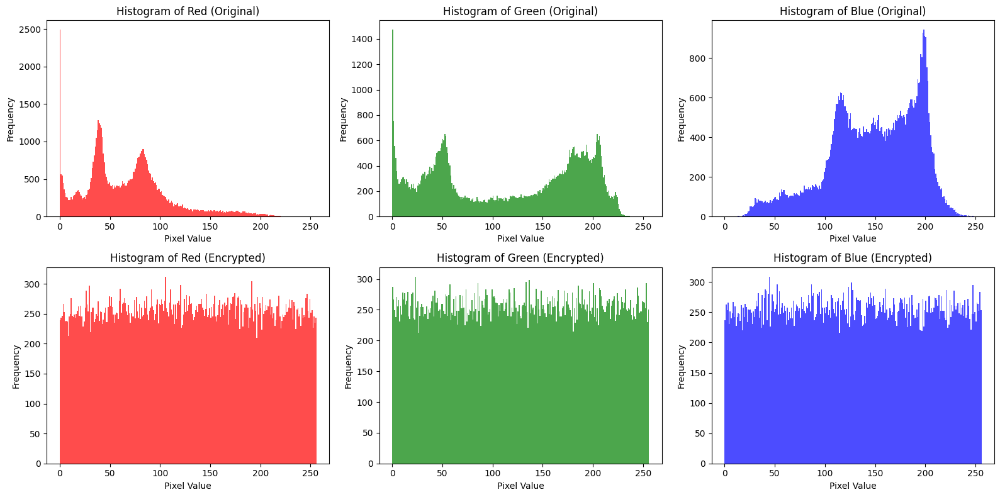

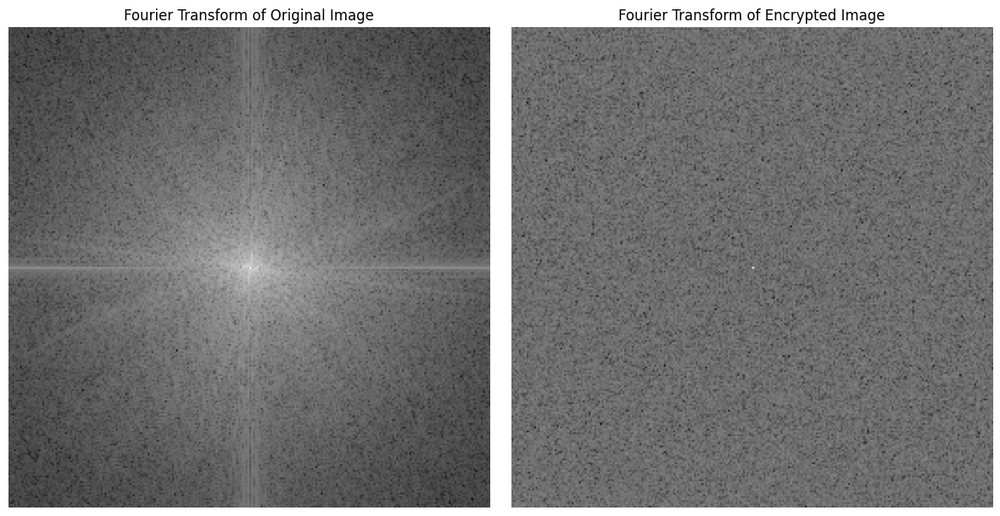

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import os
import time

def load_image(filename, mode=cv2.IMREAD_GRAYSCALE):
    if not os.path.exists(filename):
        print(f"Error: {filename} not found. Make sure encryption code runs first.")
        return None
    return cv2.imread(filename, mode)

# Load necessary images
original_color = load_image("original.png", cv2.IMREAD_COLOR)
encrypted_color = load_image("encrypted.png", cv2.IMREAD_COLOR)
R_enc = load_image("encrypted_R_channel.png")
G_enc = load_image("encrypted_G_channel.png")
B_enc = load_image("encrypted_B_channel.png")

# Check if the loaded channels are in uint8 format
if R_enc is not None:
    R_enc = R_enc.astype(np.uint8)
if G_enc is not None:
    G_enc = G_enc.astype(np.uint8)
if B_enc is not None:
    B_enc = B_enc.astype(np.uint8)

if original_color is not None:
    R, G, B = cv2.split(original_color)
    N = R.shape[0]
else:
    R, G, B, N = None, None, None, None

# entropy
def calculate_entropy(channel):
    if channel is None:
        return None
    max_val = np.iinfo(channel.dtype).max
    bins1 = max_val + 1
    hist, _ = np.histogram(channel.ravel(), bins=bins1, range=(0, bins1))
    prob_dist = hist / np.sum(hist)
    prob_dist = prob_dist[prob_dist > 0]
    entropy = -np.sum(prob_dist * np.log2(prob_dist))
    return entropy

entropy_R = calculate_entropy(R_enc)
entropy_G = calculate_entropy(G_enc)
entropy_B = calculate_entropy(B_enc)

print("Information Entropy of Encrypted Channels:")
print(f"Red Channel: {entropy_R:.6f}")
print(f"Green Channel: {entropy_G:.6f}")
print(f"Blue Channel: {entropy_B:.6f}")

# Mean Squared Error (MSE)
def calculate_mse(original, encrypted):
    if original is None or encrypted is None:
        return None
    """mse = np.mean((original.astype(np.float64) - encrypted.astype(np.float64)) ** 2)"""
    mse = np.mean((original.astype(np.float64) - encrypted.astype(np.float64)) ** 2)
    return mse

mse_R = calculate_mse(R, R_enc)
mse_G = calculate_mse(G, G_enc)
mse_B = calculate_mse(B, B_enc)

print("\nMean Squared Error (MSE) between Original and Encrypted Channels:")
print(f"Red Channel: {mse_R:.6f}")
print(f"Green Channel: {mse_G:.6f}")
print(f"Blue Channel: {mse_B:.6f}")

# Peak Signal-to-Noise Ratio (PSNR)
def calculate_psnr(mse, max_pixel=255):
    """if mse is None or mse == 0:
        return None  # Avoid division by zero
    psnr = 10 * np.log10((max_pixel ** 2) / mse)
    return psnr"""
    if mse is None or mse == 0:
        return float('inf')
    if max_pixel is None:
        max_pixel = np.iinfo(image.dtype).max if image is not None else 255
    psnr = 10 * np.log10((max_pixel ** 2) / mse)
    return psnr

psnr_R = calculate_psnr(mse_R)
psnr_G = calculate_psnr(mse_G)
psnr_B = calculate_psnr(mse_B)

print("\nPeak Signal-to-Noise Ratio (PSNR) for Encrypted Channels:")
print(f"Red Channel: {psnr_R:.6f} dB")
print(f"Green Channel: {psnr_G:.6f} dB")
print(f"Blue Channel: {psnr_B:.6f} dB")

# NPCR
def calculate_npcr(original, encrypted):
    if original is None or encrypted is None or original.shape != encrypted.shape:
        return None
    diff = original != encrypted
    npcr = (np.sum(diff) / original.size) * 100
    return npcr

npcr_R = calculate_npcr(R, R_enc)
npcr_G = calculate_npcr(G, G_enc)
npcr_B = calculate_npcr(B, B_enc)

print("\nNumber of Pixel Change Rate (NPCR):")
print(f"Red Channel: {npcr_R:.6f}%")
print(f"Green Channel: {npcr_G:.6f}%")
print(f"Blue Channel: {npcr_B:.6f}%")

# UACI
def calculate_uaci(original, encrypted):
    if original is None or encrypted is None:
        return None
    uaci = (np.sum(np.abs(original.astype(np.float64) - encrypted.astype(np.float64))) / (original.size * 255)) * 100
    return uaci

uaci_R = calculate_uaci(R, R_enc)
uaci_G = calculate_uaci(G, G_enc)
uaci_B = calculate_uaci(B, B_enc)

print("\nUnified Average Changing Intensity (UACI):")
print(f"Red Channel: {uaci_R:.6f}%")
print(f"Green Channel: {uaci_G:.6f}%")
print(f"Blue Channel: {uaci_B:.6f}%")

# Mean Absolute Error (MAE)
def calculate_mae(original, encrypted):
    if original is None or encrypted is None:
        return None
    mae = np.mean(np.abs(original.astype(np.float64) - encrypted.astype(np.float64)))
    return mae

mae_R = calculate_mae(R, R_enc)
mae_G = calculate_mae(G, G_enc)
mae_B = calculate_mae(B, B_enc)

print("\nMean Absolute Error (MAE):")
print(f"Red Channel: {mae_R:.6f}")
print(f"Green Channel: {mae_G:.6f}")
print(f"Blue Channel: {mae_B:.6f}")

#Time Analysis
print(f"\nEncryption Time: {encryption_time:.6f} seconds")

# compute keyspace
def calculate_keyspace(num_variables=9, precision=1e-16):
    keyspace = (1 / precision) ** num_variables
    keyspace_bits = np.log2(keyspace)
    return keyspace, keyspace_bits

keyspace_value, keyspace_bits = calculate_keyspace()

print(f"\nEstimated Keyspace ≈ {keyspace_value:.2e} ≈ 2^{keyspace_bits:.0f} bits\n")

# plot histogram
def plot_histogram(channel, title, position, color):
    if channel is None:
        print(f"Skipping {title} due to missing image.")
        return
    plt.subplot(2, 3, position)
    plt.hist(channel.ravel(), bins=256, range=[0, 256], color=color, alpha=0.7)
    plt.title(f"Histogram of {title}")
    plt.xlabel("Pixel Value")
    plt.ylabel("Frequency")

plt.figure(figsize=(16, 8))

plot_histogram(R, "Red (Original)", 1, 'r')
plot_histogram(G, "Green (Original)", 2, 'g')
plot_histogram(B, "Blue (Original)", 3, 'b')

plot_histogram(R_enc, "Red (Encrypted)", 4, 'r')
plot_histogram(G_enc, "Green (Encrypted)", 5, 'g')
plot_histogram(B_enc, "Blue (Encrypted)", 6, 'b')

plt.tight_layout()
plt.show()

# Fourier Transform Analysis
def plot_fourier_transform(image, title, position):
    if image is None:
        print(f"Skipping Fourier Transform for {title} due to missing image.")
        return
    f_transform = np.fft.fft2(image)
    f_transform_shifted = np.fft.fftshift(f_transform)
    magnitude_spectrum = 20 * np.log(np.abs(f_transform_shifted) + 1)

    plt.subplot(1, 2, position)
    plt.imshow(magnitude_spectrum, cmap='gray')
    plt.title(f'Fourier Transform of {title}')
    plt.axis('off')

plt.figure(figsize=(12, 6))

plot_fourier_transform(cv2.cvtColor(original_color, cv2.COLOR_BGR2GRAY), "Original Image", 1)
plot_fourier_transform(cv2.cvtColor(encrypted_color, cv2.COLOR_BGR2GRAY), "Encrypted Image", 2)

plt.tight_layout()
plt.show()


In [ ]:
import cv2
import numpy as np
import os

def load_image(filename, mode=cv2.IMREAD_COLOR):
    if not os.path.exists(filename):
        print(f"Error: {filename} not found.")
        return None
    return cv2.imread(filename, mode)

# Load the necessary images
original_color = load_image("original.png")
encrypted_color = load_image("encrypted.png")

if original_color is not None and encrypted_color is not None:
    R, G, B = cv2.split(original_color)
    R_enc, G_enc, B_enc = cv2.split(encrypted_color)
else:
    R, G, B, R_enc, G_enc, B_enc = [None] * 6

def extract_adjacent_pixels(image, direction):
    if image is None:
        return None, None

    h, w = image.shape
    if direction == "horizontal":
        x = image[:, :-1].flatten()
        y = image[:, 1:].flatten()
    elif direction == "vertical":
        x = image[:-1, :].flatten()
        y = image[1:, :].flatten()
    elif direction == "diagonal":
        x = image[:-1, :-1].flatten()
        y = image[1:, 1:].flatten()
    else:
        return None, None

    return x, y

# Correlation Coefficient Calculation
def calculate_correlation(image_original, image_encrypted, direction):
    x_plain, y_plain = extract_adjacent_pixels(image_original, direction)
    x_enc, y_enc = extract_adjacent_pixels(image_encrypted, direction)

    if x_plain is None or y_plain is None or x_enc is None or y_enc is None:
        return None, None

    plain_corr = np.corrcoef(x_plain, y_plain)[0, 1]
    enc_corr = np.corrcoef(x_enc, y_enc)[0, 1]
    return plain_corr, enc_corr

directions = ["horizontal", "vertical", "diagonal"]
channels = {"Red": (R, R_enc), "Green": (G, G_enc), "Blue": (B, B_enc)}

print("\nCorrelation Coefficient Analysis:\n")

for channel_name, (orig, enc) in channels.items():
    print(f"Channel: {channel_name}")
    for direction in directions:
        plain_corr, enc_corr = calculate_correlation(orig, enc, direction)
        print(f"  {direction.capitalize()} - Plain: {plain_corr:.6f}, Encrypted: {enc_corr:.6f}")
    print()



Correlation Coefficient Analysis:

Channel: Red
  Horizontal - Plain: 0.960550, Encrypted: -0.001925
  Vertical - Plain: 0.969234, Encrypted: 0.002610
  Diagonal - Plain: 0.932369, Encrypted: 0.001709

Channel: Green
  Horizontal - Plain: 0.979673, Encrypted: 0.003783
  Vertical - Plain: 0.985441, Encrypted: 0.000791
  Diagonal - Plain: 0.964934, Encrypted: -0.005757

Channel: Blue
  Horizontal - Plain: 0.966044, Encrypted: 0.001775
  Vertical - Plain: 0.972556, Encrypted: 0.006833
  Diagonal - Plain: 0.940728, Encrypted: -0.000547



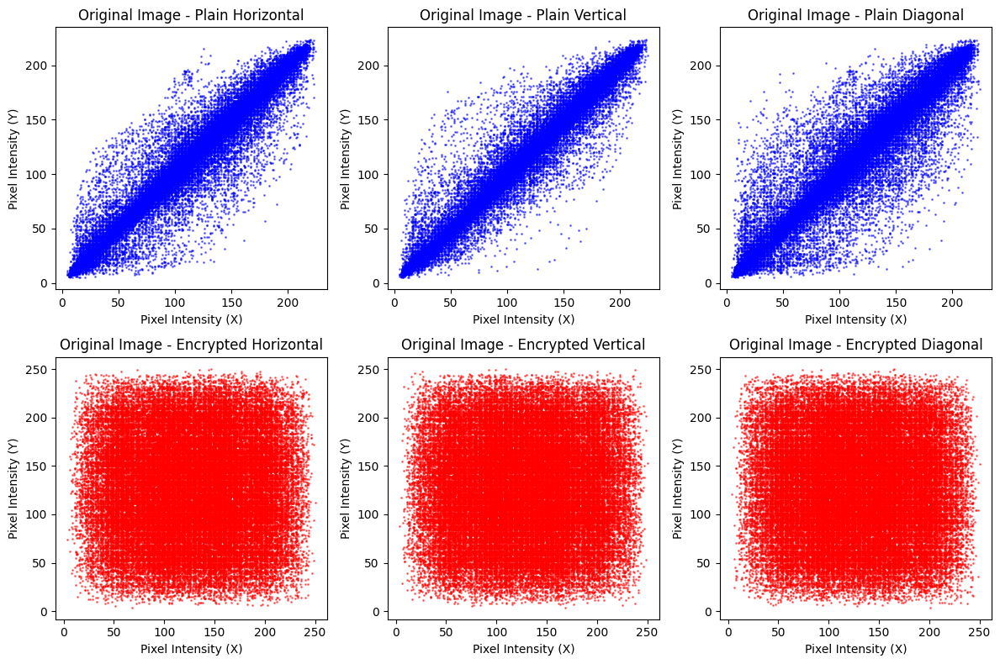

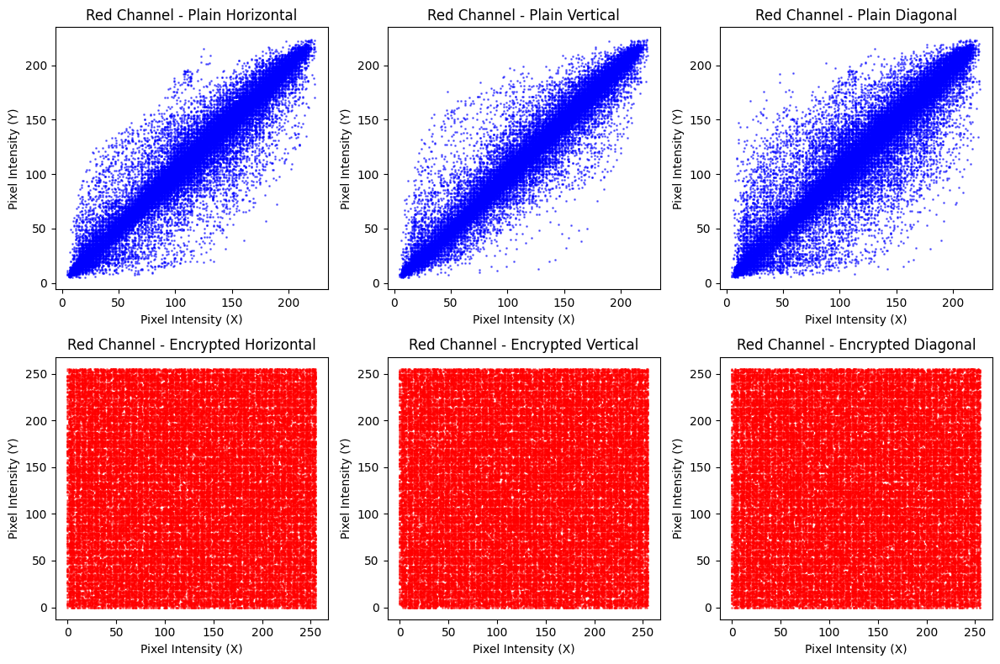

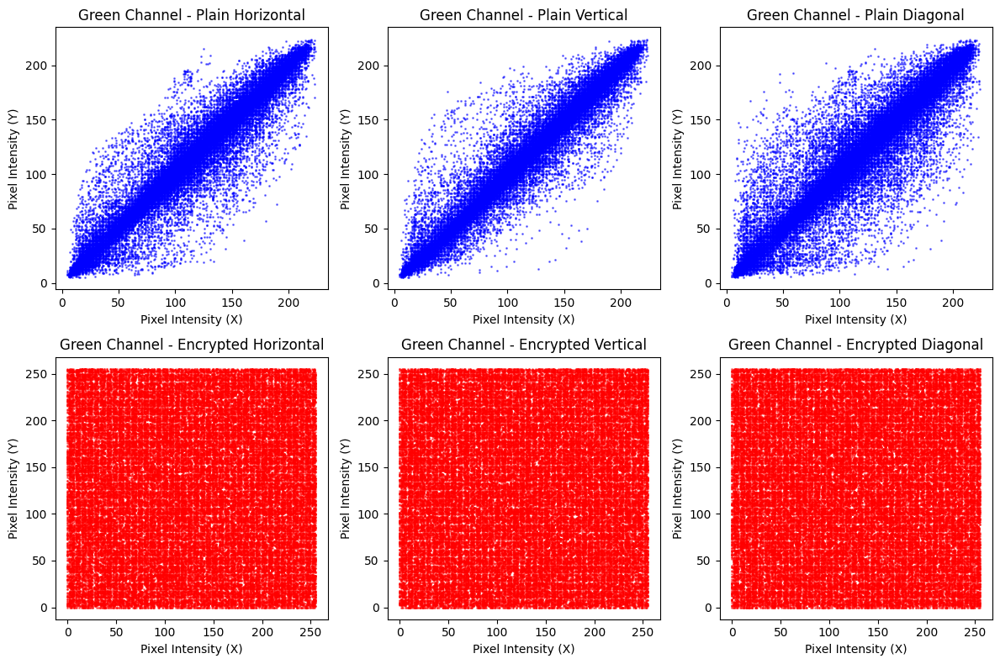

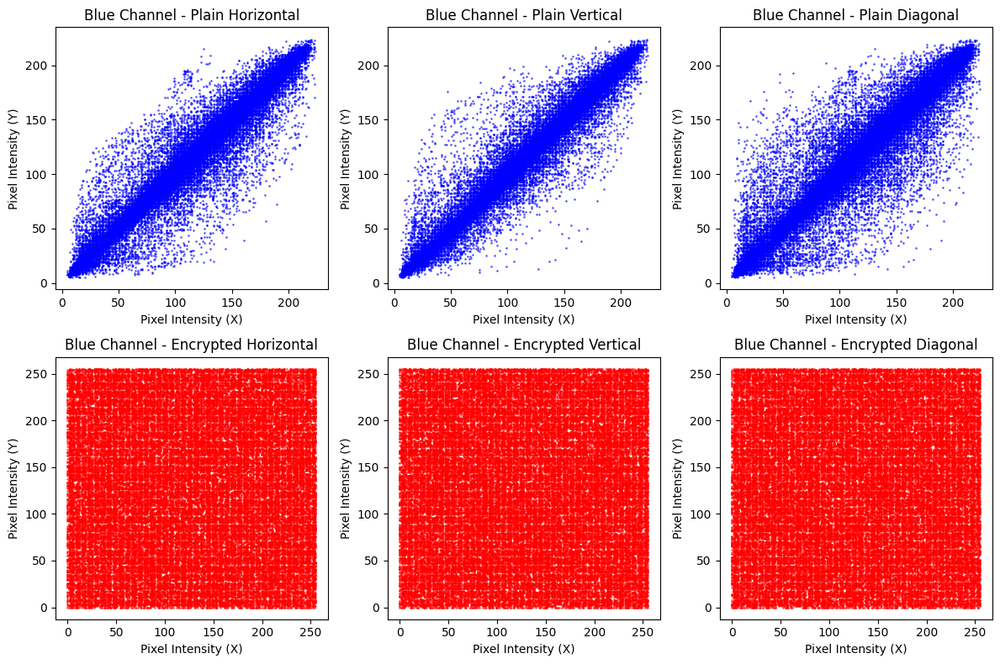

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import os

def load_image(filename):
    if not os.path.exists(filename):
        print(f"Error: {filename} not found.")
        return None
    return cv2.imread(filename, cv2.IMREAD_GRAYSCALE)

# Loading the necessary images
original_gray = load_image("original.png")
encrypted_gray = load_image("encrypted.png")
encrypted_red = load_image("encrypted_R_channel.png")
encrypted_green = load_image("encrypted_G_channel.png")
encrypted_blue = load_image("encrypted_B_channel.png")

def extract_adjacent_pixels(image, direction):
    if image is None:
        return None, None

    h, w = image.shape
    if direction == "horizontal":
        x = image[:, :-1].flatten()
        y = image[:, 1:].flatten()
    elif direction == "vertical":
        x = image[:-1, :].flatten()
        y = image[1:, :].flatten()
    elif direction == "diagonal":
        x = image[:-1, :-1].flatten()
        y = image[1:, 1:].flatten()
    else:
        return None, None

    return x, y

def plot_correlation(image_plain, image_enc, title):
    if image_plain is None or image_enc is None:
        print(f"Skipping {title} correlation diagrams due to missing data.")
        return

    directions = ["horizontal", "vertical", "diagonal"]
    plt.figure(figsize=(12, 8))

    for i, direction in enumerate(directions, 1):
        x_plain, y_plain = extract_adjacent_pixels(image_plain, direction)
        x_enc, y_enc = extract_adjacent_pixels(image_enc, direction)

        if x_plain is None or y_plain is None or x_enc is None or y_enc is None:
            continue

        plt.subplot(2, 3, i)
        plt.scatter(x_plain, y_plain, s=1, color='blue', alpha=0.5)
        plt.title(f"{title} - Plain {direction.capitalize()}")
        plt.xlabel("Pixel Intensity (X)")
        plt.ylabel("Pixel Intensity (Y)")

        plt.subplot(2, 3, i + 3)
        plt.scatter(x_enc, y_enc, s=1, color='red', alpha=0.5)
        plt.title(f"{title} - Encrypted {direction.capitalize()}")
        plt.xlabel("Pixel Intensity (X)")
        plt.ylabel("Pixel Intensity (Y)")

    plt.tight_layout()
    plt.show()

# 1. Original Image Correlation (6 diagrams)
plot_correlation(original_gray, encrypted_gray, "Original Image")

# 2. Encrypted Red Channel Correlation (6 diagrams)
plot_correlation(original_gray, encrypted_red, "Red Channel")

# 3. Encrypted Green Channel Correlation (6 diagrams)
plot_correlation(original_gray, encrypted_green, "Green Channel")

# 4. Encrypted Blue Channel Correlation (6 diagrams)
plot_correlation(original_gray, encrypted_blue, "Blue Channel")


In [ ]:
import numpy as np
from math import log2, sqrt, erfc, log, exp
from numpy.linalg import norm
import sys
import random
from scipy.special import gammaincc, erfc
from scipy.fft import fft
from scipy.stats import chi2, norm as scipy_norm
from collections import defaultdict
from itertools import groupby

SIGNIFICANCE_LEVEL = 0.01

# Load bitstream from file
def load_bitstream(filepath):
    with open(filepath, 'r') as f:
        bits = f.read().strip()
    return np.array([int(b) for b in bits])

# ----------------------------
# Test 1: Frequency (Monobit)
def frequency_monobit_test(bits):
    n = len(bits)
    s = np.sum(2*bits - 1)
    p_value = erfc(abs(s)/sqrt(n*2))
    return p_value

# Test 2: Block Frequency Test
def frequency_block_test(bits, M):
    n = len(bits)
    N = n // M
    if N == 0:
        return 0.0  # Not enough bits for even one block

    chi_squared = 0.0
    for i in range(N):
        block = bits[i * M:(i + 1) * M]
        pi = np.sum(block) / M
        chi_squared += (pi - 0.5) ** 2

    chi_squared *= 4.0 * M
    p_value = gammaincc(N / 2.0, chi_squared / 2.0)
    return p_value

# Test 3: Runs Test
def runs_test(bits):
    n = len(bits)
    pi = np.mean(bits)
    if abs(pi - 0.5) >= 0.01:
        return 0.0
    v_obs = 1 + sum(bits[i] != bits[i+1] for i in range(n - 1))
    p_value = erfc(abs(v_obs - 2*n*pi*(1 - pi)) / (2 * sqrt(2*n) * pi * (1 - pi)))
    return p_value

# Test 4: Longest Run of Ones in a Block
def longest_run_ones_test(bits):
    n = len(bits)

    if n < 128:
        return None  # Test not applicable

    # Select parameters based on n (same logic as C)
    if n < 6272:
        K = 3
        M = 8
        V = [1, 2, 3, 4]
        pi = [0.21484375, 0.3671875, 0.23046875, 0.1875]
    elif n < 750000:
        K = 5
        M = 128
        V = [4, 5, 6, 7, 8, 9]
        pi = [0.1174035788, 0.242955959, 0.249363483,
              0.17517706, 0.102701071, 0.112398847]
    else:
        K = 6
        M = 10000
        V = [10, 11, 12, 13, 14, 15, 16]
        pi = [0.0882, 0.2092, 0.2483,
              0.1933, 0.1208, 0.0675, 0.0727]

    N = n // M
    nu = [0] * (K + 1)

    for i in range(N):
        block = bits[i*M:(i+1)*M]
        max_run = max(len(list(g)) for b, g in groupby(block) if b == 1)

        if max_run < V[0]:
            nu[0] += 1
        elif max_run > V[K]:
            nu[K] += 1
        else:
            for j in range(K):
                if max_run == V[j]:
                    nu[j] += 1
                    break

    # Chi-squared test
    chi2 = sum([(nu[i] - N * pi[i]) ** 2 / (N * pi[i]) for i in range(K + 1)])
    p_value = gammaincc(K / 2.0, chi2 / 2.0)
    return p_value

# Test 5: Binary Matrix Rank Test
def matrix_rank_test(bits, matrix_size=32):
    n = len(bits)
    N = n // (matrix_size**2)
    if N == 0:
        return 0.0

    ranks = []
    for i in range(N):
        sub_bits = bits[i*matrix_size**2:(i+1)*matrix_size**2]
        if len(sub_bits) != matrix_size**2:
            continue  # skip incomplete block
        matrix = np.array(sub_bits).reshape((matrix_size, matrix_size))
        ranks.append(np.linalg.matrix_rank(matrix))

    if len(ranks) == 0:
        return 0.0

    full_rank = ranks.count(matrix_size)
    proportion = full_rank / len(ranks)
    expected = 0.2888
    chi_squared = len(ranks) * ((proportion - expected)**2 / expected)
    return exp(-chi_squared)

# Test 6: Discrete Fourier Transform (Spectral)
def dft_test(bits):
    n = len(bits)
    X = 2*bits - 1
    S = np.abs(fft(X))[:n//2]
    T = sqrt(log(1/0.05) * n)
    N0 = 0.95 * n / 2
    N1 = sum(s < T for s in S)
    d = (N1 - N0)/sqrt(n*0.95*0.05/4)
    p_value = erfc(abs(d)/sqrt(2))
    return p_value

# Test 7: Non-Overlapping Template Matching
def non_overlapping_template_matching_test(bits, m=9, template=None):
    if template is None:
        template = np.zeros(m, dtype=int)
    template = np.array(template)
    n = len(bits)
    N = n // 1032
    M = 1032
    if N == 0:
        return 0.0, "FAIL (input too short)"
    blocks = np.array_split(bits[:N * M], N)
    W = np.zeros(N)

    for i, block in enumerate(blocks):
        count = 0
        j = 0
        while j <= M - m:
            if np.array_equal(block[j:j + m], template):
                count += 1
                j += m
            else:
                j += 1
        W[i] = count

    mean = (M - m + 1) / (2 ** m)
    var = M * ((1 / (2 ** m)) - ((2 * m - 1) / (2 ** (2 * m))))
    chi_squared = np.sum(((W - mean) ** 2) / var)
    p_value = gammaincc(N / 2, chi_squared / 2)

    return p_value, "PASS" if p_value >= 0.01 else "FAIL"

# Test 8: Overlapping Template Matching
def overlapping_template_matching_test(bits, m=9, template=None):
    if template is None:
        template = np.ones(m, dtype=int)
    template = np.array(template)
    n = len(bits)
    M = 1032
    N = n // M
    if N == 0:
        return 0.0, "FAIL (input too short)"
    blocks = np.array_split(bits[:N * M], N)
    lambda_val = (M - m + 1) / (2 ** m)
    eta = lambda_val
    pi = [np.exp(-eta)]
    for i in range(1, 6):
        pi.append(pi[i - 1] * eta / i)
    pi.append(1 - sum(pi[:5]))

    frequencies = np.zeros(6)
    for block in blocks:
        count = 0
        i = 0
        while i <= M - m:
            if np.array_equal(block[i:i + m], template):
                count += 1
                i += 1
            else:
                i += 1
        frequencies[min(count, 5)] += 1

    chi_squared = np.sum([(frequencies[i] - N * pi[i]) ** 2 / (N * pi[i]) for i in range(6)])
    p_value = gammaincc(5 / 2, chi_squared / 2)

    return p_value, "PASS" if p_value >= 0.01 else "FAIL"

# Test 9: Maurer's Universal Test
def universal_test(bits):
    n = len(bits)

    # Choose L based on input length n
    L_values = [0, 0, 0, 0, 0, 0, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16]
    expected_value = [0, 0, 0, 0, 0, 0, 5.2177052, 6.1962507, 7.1836656,
                      8.1764248, 9.1723243, 10.170032, 11.168765,
                      12.168070, 13.167693, 14.167488, 15.167379]
    variance = [0, 0, 0, 0, 0, 0, 2.954, 3.125, 3.238, 3.311, 3.356, 3.384,
                3.401, 3.410, 3.416, 3.419, 3.421]

    # Choose L dynamically
    L = 5
    if n >= 387840:     L = 6
    if n >= 904960:     L = 7
    if n >= 2068480:    L = 8
    if n >= 4654080:    L = 9
    if n >= 10342400:   L = 10
    if n >= 22753280:   L = 11
    if n >= 49643520:   L = 12
    if n >= 107560960:  L = 13
    if n >= 231669760:  L = 14
    if n >= 496435200:  L = 15
    if n >= 1059061760: L = 16

    Q = 10 * (2 ** L)
    K = (n // L) - Q
    p = 2 ** L

    if L < 6 or L > 16 or K <= 0:
        return None  # Invalid parameters for the test

    T = np.zeros(p, dtype=int)
    sum_phi = 0.0

    # Initialization phase: populate T with last-seen positions
    for i in range(Q):
        dec_rep = 0
        for j in range(L):
            dec_rep = (dec_rep << 1) + bits[i * L + j]
        T[dec_rep] = i + 1

    # Testing phase
    for i in range(Q, Q + K):
        dec_rep = 0
        for j in range(L):
            dec_rep = (dec_rep << 1) + bits[i * L + j]
        distance = i + 1 - T[dec_rep]
        T[dec_rep] = i + 1
        sum_phi += log2(distance)

    phi = sum_phi / K

    c = 0.7 - 0.8 / L + ((4 + 32 / L) * (K ** (-3 / L)) / 15)
    sigma = c * sqrt(variance[L] / K)
    arg = abs(phi - expected_value[L]) / (sqrt(2) * sigma)
    p_value = erfc(arg)

    return p_value

# Test 10: Linear Complexity Test (using Berlekamp-Massey)
def linear_complexity_test(bits, M):
    n = len(bits)
    K = 6
    pi = [0.01047, 0.03125, 0.12500, 0.50000, 0.25000, 0.06250, 0.020833]
    N = n // M
    if N == 0:
        return 0.0

    nu = [0] * 7

    for block in range(N):
        B = np.zeros(M, dtype=int)
        C = np.zeros(M, dtype=int)
        T = np.zeros(M, dtype=int)
        P = np.zeros(M, dtype=int)
        C[0] = 1
        B[0] = 1
        L = 0
        m = -1

        block_bits = bits[block*M : (block+1)*M]
        N_ = 0
        while N_ < M:
            d = block_bits[N_]
            for i in range(1, L+1):
                d ^= C[i] & block_bits[N_ - i]
            if d == 1:
                T[:] = C[:]
                P[:] = 0
                for j in range(M):
                    if B[j] == 1 and j + N_ - m < M:
                        P[j + N_ - m] = 1
                C = (C ^ P) % 2
                if L <= N_ // 2:
                    L = N_ + 1 - L
                    m = N_
                    B[:] = T[:]
            N_ += 1

        parity = (M + 1) % 2
        sign = -1 if parity == 0 else 1
        mean = M / 2.0 + (9.0 + sign) / 36.0 - (1.0 / (2**M)) * (M / 3.0 + 2.0 / 9.0)

        parity = M % 2
        sign = 1 if parity == 0 else -1
        T_ = sign * (L - mean) + 2.0 / 9.0

        if T_ <= -2.5:
            nu[0] += 1
        elif T_ <= -1.5:
            nu[1] += 1
        elif T_ <= -0.5:
            nu[2] += 1
        elif T_ <= 0.5:
            nu[3] += 1
        elif T_ <= 1.5:
            nu[4] += 1
        elif T_ <= 2.5:
            nu[5] += 1
        else:
            nu[6] += 1

    chi2 = sum(((nu[i] - N * pi[i])**2) / (N * pi[i]) for i in range(7))
    p_value = gammaincc(K / 2.0, chi2 / 2.0)
    return p_value

# Test 11: Serial Test
def psi2(bits, m):
    n = len(bits)
    if m <= 0:
        return 0.0

    pow_len = 2 ** (m + 1) - 1
    P = [0] * pow_len

    for i in range(n):
        k = 1
        for j in range(m):
            bit = bits[(i + j) % n]
            if bit == 0:
                k *= 2
            else:
                k = 2 * k + 1
        P[k - 1] += 1

    sum_val = 0.0
    for i in range(2 ** m - 1, 2 ** (m + 1) - 1):
        sum_val += P[i] ** 2

    sum_val = (sum_val * (2 ** m) / n) - n
    return sum_val

def serial_test(bits, m):
    n = len(bits)

    psim0 = psi2(bits, m)
    psim1 = psi2(bits, m - 1)
    psim2 = psi2(bits, m - 2)

    del1 = psim0 - psim1
    del2 = psim0 - 2 * psim1 + psim2

    p_value1 = gammaincc(2 ** (m - 1) / 2, del1 / 2.0)
    p_value2 = gammaincc(2 ** (m - 2) / 2, del2 / 2.0)

    return p_value1, p_value2

# Test 12: Approximate Entropy
def approximate_entropy_test(bits, m):
    n = len(bits)
    ApEn = []

    for block_size in [m, m + 1]:
        if block_size == 0:
            ApEn.append(0.0)
            continue

        num_of_blocks = n
        pow_len = 2 ** (block_size + 1) - 1
        P = [0] * pow_len

        for i in range(n):
            k = 1
            for j in range(block_size):
                k <<= 1
                if bits[(i + j) % n] == 1:
                    k += 1
            P[k - 1] += 1

        sum_val = 0.0
        index = 2 ** block_size - 1
        for i in range(2 ** block_size):
            if P[index] > 0:
                sum_val += P[index] * log(P[index] / num_of_blocks)
            index += 1

        sum_val /= num_of_blocks
        ApEn.append(sum_val)

    apen = ApEn[0] - ApEn[1]
    chi_squared = 2.0 * n * (log(2) - apen)
    p_value = gammaincc(pow(2, m - 1), chi_squared / 2.0)

    return p_value

# Test 13: Cumulative Sums
def cumulative_sums_test(bits):
    n = len(bits)
    X = np.array([2 * b - 1 for b in bits])

    # Forward cumulative sums
    S = np.cumsum(X)
    z = np.max(np.abs(S))

    def compute_p_value(z, n):
        sum1 = 0.0
        for k in range(int(np.floor((-n / z + 1) / 4)), int(np.floor((n / z - 1) / 4)) + 1):
            term = scipy_norm.cdf((4 * k + 1) * z / sqrt(n)) - scipy_norm.cdf((4 * k - 1) * z / sqrt(n))
            sum1 += term

        sum2 = 0.0
        for k in range(int(np.floor((-n / z - 3) / 4)), int(np.floor((n / z - 1) / 4)) + 1):
            term = scipy_norm.cdf((4 * k + 3) * z / sqrt(n)) - scipy_norm.cdf((4 * k + 1) * z / sqrt(n))
            sum2 += term

        p_value = 1.0 - sum1 + sum2
        return p_value

    p_value_forward = compute_p_value(z, n)
    p_value_backward = compute_p_value(np.max(np.abs(np.cumsum(X[::-1]))), n)

    return p_value_forward, p_value_backward

# Test 14: Random Excursions Test
def random_excursions_test(bits):
    X = 2*bits - 1
    S = np.insert(np.cumsum(X), 0, 0)
    cycles = np.where(S == 0)[0]
    if len(cycles) < 2:
        return 0.0
    J = len(cycles) - 1
    state_counts = {x: [] for x in range(-4, 5) if x != 0}
    for i in range(J):
        cycle = S[cycles[i]:cycles[i+1]+1]
        for x in state_counts:
            state_counts[x].append(np.count_nonzero(cycle == x))
    p_values = []
    pi_k = {1:[0.5, 0.25, 0.125, 0.0625, 0.03125, 0.03125],
            2:[0.75, 0.0625, 0.046875, 0.03515625, 0.0263671875, 0.0791015625]}
    for x in state_counts:
        count = np.bincount(state_counts[x], minlength=6)
        s_obs = count[:6]
        expected = [pi_k[1][i] * J for i in range(6)]
        chi2 = sum((s_obs[i] - expected[i])**2 / expected[i] for i in range(6))
        p = gammaincc(5/2, chi2/2)
        p_values.append(p)
    return np.mean(p_values)

# Test 15: Random Excursions Variant Test
def random_excursions_variant_test(bits):
    X = 2*bits - 1
    S = np.insert(np.cumsum(X), 0, 0)
    cycles = np.where(S == 0)[0]
    if len(cycles) < 2:
        return 0.0
    J = len(cycles) - 1
    state_counts = defaultdict(int)
    for i in range(J):
        cycle = S[cycles[i]:cycles[i+1]+1]
        for x in range(-9, 10):
            if x != 0:
                state_counts[x] += np.count_nonzero(cycle == x)
    p_values = []
    for x in state_counts:
        p = erfc(abs(state_counts[x] - J)/sqrt(2 * J * (4 * abs(x) - 2)))
        p_values.append(p)
    return np.mean(p_values)

# Summarise serial test
def summarize_serial_result(serial_result, label):
    if isinstance(serial_result, tuple) and len(serial_result) == 2:
        p1, p2 = serial_result
        if isinstance(p1, float) and isinstance(p2, float):
            if p1 >= SIGNIFICANCE_LEVEL and p2 >= SIGNIFICANCE_LEVEL:
                return (label, min(p1, p2))  # or use (p1 + p2) / 2 if preferred
            else:
                return (label, 0.0)
        else:
            return (label, "Error")
    else:
        return (label, "Error")
'''
# Summarising 14, 15 for display
def summarize_excursions_results(p_values, test_name):
    if not isinstance(p_values, dict):
        return (test_name, "NA")  # error or insufficient cycles

    p_vals = [p for p in p_values.values() if isinstance(p, float)]
    if len(p_vals) == 0:
        return (test_name, "NA")

    result = all(p >= SIGNIFICANCE_LEVEL for p in p_vals)
    return (test_name, min(p_vals) if result else 0.0)
'''
# Run all tests
def run_all_tests(bits, label):
    print(f"\n--- Results for {label} ---")

    results = []

    # 1 to 6
    results.append(("1. Frequency Monobit", frequency_monobit_test(bits)))
    results.append(("2. Block Frequency", frequency_block_test(bits, M=128)))
    results.append(("3. Runs", runs_test(bits)))
    results.append(("4. Longest Run of 1s", longest_run_ones_test(bits)))
    results.append(("5. Matrix Rank", matrix_rank_test(bits)))
    results.append(("6. DFT", dft_test(bits)))

    # 7 and 8 - template tests
    p7, _ = non_overlapping_template_matching_test(bits)
    results.append(("7. Non-Overlapping Template", p7))
    p8, _ = overlapping_template_matching_test(bits)
    results.append(("8. Overlapping Template", p8))

    # 9 to 12
    results.append(("9. Maurer's Test", universal_test(bits)))
    results.append(("10. Linear Complexity", linear_complexity_test(bits, M=500)))
    serial_result = serial_test(bits, m=3)
    results.append(summarize_serial_result(serial_result, "11. Serial"))
    results.append(("12. Approx. Entropy", approximate_entropy_test(bits, m=3)))

    # 13. Cumulative Sums (Forward & Reverse)
    p_forward, p_reverse = cumulative_sums_test(bits)
    results.append(("13. Cumulative Sums (Forward)", p_forward))
    results.append(("13. Cumulative Sums (Reverse)", p_reverse))

    results.append(("14. Random Excursions", random_excursions_test(bits)))
    results.append(("15. Random Exc. Variant", random_excursions_variant_test(bits)))
    '''
    # 14. Random Excursions
    excursions = random_excursions_test(bits)
    results.append(summarize_excursions_results(excursions, "14. Random Excursions"))

    # 15. Random Exc. Variant
    excursions_var = random_excursions_variant_test(bits)
    results.append(summarize_excursions_results(excursions_var, "15. Random Exc. Variant"))
    '''
    # --- Display neatly ---
    for name, p in results:
      if isinstance(p, float):
        result = "PASS" if p >= SIGNIFICANCE_LEVEL else "FAIL"
        print(f"{name:<45} p = {p:.5f} => {result}")
      elif isinstance(p, str):
          print(f"{name:<45} p = {p} => NA")
      else:
          print(f"{name:<45} p = {p} => FAIL (Error)")


def state_result_label(p):
    if isinstance(p, float):
        return "PASS" if p >= SIGNIFICANCE_LEVEL else "FAIL"
    return p  # return error string

# --- Load bitstreams and run ---
encrypted_bits = load_bitstream("/content/final_encrypted_image_bits.txt")
key1_bits = load_bitstream("/content/key1_bits.txt")
key2_bits = load_bitstream("/content/key2_bits.txt")

run_all_tests(encrypted_bits, "Encrypted Image")
run_all_tests(key1_bits, "Key 1")
run_all_tests(key2_bits, "Key 2")



--- Results for Encrypted Image ---
1. Frequency Monobit                          p = 0.16051 => PASS
2. Block Frequency                            p = 0.01221 => PASS
3. Runs                                       p = 0.00449 => FAIL
4. Longest Run of 1s                          p = 0.08706 => PASS
5. Matrix Rank                                p = 0.00000 => FAIL
6. DFT                                        p = 0.53205 => PASS
7. Non-Overlapping Template                   p = 0.03548 => PASS
8. Overlapping Template                       p = 0.00000 => FAIL
9. Maurer's Test                              p = 0.18287 => PASS
10. Linear Complexity                         p = 0.77257 => PASS
11. Serial                                    p = 0.03118 => PASS
12. Approx. Entropy                           p = 0.08430 => PASS
13. Cumulative Sums (Forward)                 p = 0.20260 => PASS
13. Cumulative Sums (Reverse)                 p = 0.21105 => PASS
14. Random Excursions                  

In [ ]:
import numpy as np
from math import log2, sqrt, erfc, log, exp
from numpy.linalg import norm
import sys
import random
from scipy.special import gammaincc, erfc
from scipy.fft import fft
from scipy.stats import chi2, norm as scipy_norm
from collections import defaultdict
from itertools import groupby

SIGNIFICANCE_LEVEL = 0.01

# Load bitstream from file
def load_bitstream(filepath):
    with open(filepath, 'r') as f:
        bits = f.read().strip()
    return np.array([int(b) for b in bits])

# ----------------------------
# Test 1: Frequency (Monobit)
def frequency_monobit_test(bits):
    n = len(bits)
    s = np.sum(2*bits - 1)
    p_value = erfc(abs(s)/sqrt(n*2))
    return p_value

# Test 2: Block Frequency Test
def frequency_block_test(bits, M):
    n = len(bits)
    N = n // M
    if N == 0:
        return 0.0  # Not enough bits for even one block

    chi_squared = 0.0
    for i in range(N):
        block = bits[i * M:(i + 1) * M]
        pi = np.sum(block) / M
        chi_squared += (pi - 0.5) ** 2

    chi_squared *= 4.0 * M
    p_value = gammaincc(N / 2.0, chi_squared / 2.0)
    return p_value

# Test 3: Runs Test
def runs_test(bits):
    n = len(bits)
    pi = np.mean(bits)
    if abs(pi - 0.5) >= 0.01:
        return 0.0
    v_obs = 1 + sum(bits[i] != bits[i+1] for i in range(n - 1))
    p_value = erfc(abs(v_obs - 2*n*pi*(1 - pi)) / (2 * sqrt(2*n) * pi * (1 - pi)))
    return p_value

# Test 4: Longest Run of Ones in a Block
def longest_run_ones_test(bits):
    n = len(bits)

    if n < 128:
        return None  # Test not applicable

    # Select parameters based on n (same logic as C)
    if n < 6272:
        K = 3
        M = 8
        V = [1, 2, 3, 4]
        pi = [0.21484375, 0.3671875, 0.23046875, 0.1875]
    elif n < 750000:
        K = 5
        M = 128
        V = [4, 5, 6, 7, 8, 9]
        pi = [0.1174035788, 0.242955959, 0.249363483,
              0.17517706, 0.102701071, 0.112398847]
    else:
        K = 6
        M = 10000
        V = [10, 11, 12, 13, 14, 15, 16]
        pi = [0.0882, 0.2092, 0.2483,
              0.1933, 0.1208, 0.0675, 0.0727]

    N = n // M
    nu = [0] * (K + 1)

    for i in range(N):
        block = bits[i*M:(i+1)*M]
        max_run = max(len(list(g)) for b, g in groupby(block) if b == 1)

        if max_run < V[0]:
            nu[0] += 1
        elif max_run > V[K]:
            nu[K] += 1
        else:
            for j in range(K):
                if max_run == V[j]:
                    nu[j] += 1
                    break

    # Chi-squared test
    chi2 = sum([(nu[i] - N * pi[i]) ** 2 / (N * pi[i]) for i in range(K + 1)])
    p_value = gammaincc(K / 2.0, chi2 / 2.0)
    return p_value

# Test 5: Binary Matrix Rank Test
def matrix_rank_test(bits, matrix_size=32):
    n = len(bits)
    N = n // (matrix_size**2)
    if N == 0:
        return 0.0

    ranks = []
    for i in range(N):
        sub_bits = bits[i*matrix_size**2:(i+1)*matrix_size**2]
        if len(sub_bits) != matrix_size**2:
            continue  # skip incomplete block
        matrix = np.array(sub_bits).reshape((matrix_size, matrix_size))
        ranks.append(np.linalg.matrix_rank(matrix))

    if len(ranks) == 0:
        return 0.0

    full_rank = ranks.count(matrix_size)
    proportion = full_rank / len(ranks)
    expected = 0.2888
    chi_squared = len(ranks) * ((proportion - expected)**2 / expected)
    return exp(-chi_squared)

# Test 6: Discrete Fourier Transform (Spectral)
def dft_test(bits):
    n = len(bits)
    X = 2*bits - 1
    S = np.abs(fft(X))[:n//2]
    T = sqrt(log(1/0.05) * n)
    N0 = 0.95 * n / 2
    N1 = sum(s < T for s in S)
    d = (N1 - N0)/sqrt(n*0.95*0.05/4)
    p_value = erfc(abs(d)/sqrt(2))
    return p_value

# Test 7: Non-Overlapping Template Matching
def non_overlapping_template_matching_test(bits, m=9, template=None):
    if template is None:
        template = np.zeros(m, dtype=int)
    template = np.array(template)
    n = len(bits)
    N = n // 1032
    M = 1032
    if N == 0:
        return 0.0, "FAIL (input too short)"
    blocks = np.array_split(bits[:N * M], N)
    W = np.zeros(N)

    for i, block in enumerate(blocks):
        count = 0
        j = 0
        while j <= M - m:
            if np.array_equal(block[j:j + m], template):
                count += 1
                j += m
            else:
                j += 1
        W[i] = count

    mean = (M - m + 1) / (2 ** m)
    var = M * ((1 / (2 ** m)) - ((2 * m - 1) / (2 ** (2 * m))))
    chi_squared = np.sum(((W - mean) ** 2) / var)
    p_value = gammaincc(N / 2, chi_squared / 2)

    return p_value, "PASS" if p_value >= 0.01 else "FAIL"

# Test 8: Overlapping Template Matching
def overlapping_template_matching_test(bits, m=9, template=None):
    if template is None:
        template = np.ones(m, dtype=int)
    template = np.array(template)
    n = len(bits)
    M = 1032
    N = n // M
    if N == 0:
        return 0.0, "FAIL (input too short)"
    blocks = np.array_split(bits[:N * M], N)
    lambda_val = (M - m + 1) / (2 ** m)
    eta = lambda_val
    pi = [np.exp(-eta)]
    for i in range(1, 6):
        pi.append(pi[i - 1] * eta / i)
    pi.append(1 - sum(pi[:5]))

    frequencies = np.zeros(6)
    for block in blocks:
        count = 0
        i = 0
        while i <= M - m:
            if np.array_equal(block[i:i + m], template):
                count += 1
                i += 1
            else:
                i += 1
        frequencies[min(count, 5)] += 1

    chi_squared = np.sum([(frequencies[i] - N * pi[i]) ** 2 / (N * pi[i]) for i in range(6)])
    p_value = gammaincc(5 / 2, chi_squared / 2)

    return p_value, "PASS" if p_value >= 0.01 else "FAIL"

# Test 9: Maurer's Universal Test
def universal_test(bits):
    n = len(bits)

    # Choose L based on input length n
    L_values = [0, 0, 0, 0, 0, 0, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16]
    expected_value = [0, 0, 0, 0, 0, 0, 5.2177052, 6.1962507, 7.1836656,
                      8.1764248, 9.1723243, 10.170032, 11.168765,
                      12.168070, 13.167693, 14.167488, 15.167379]
    variance = [0, 0, 0, 0, 0, 0, 2.954, 3.125, 3.238, 3.311, 3.356, 3.384,
                3.401, 3.410, 3.416, 3.419, 3.421]

    # Choose L dynamically
    L = 5
    if n >= 387840:     L = 6
    if n >= 904960:     L = 7
    if n >= 2068480:    L = 8
    if n >= 4654080:    L = 9
    if n >= 10342400:   L = 10
    if n >= 22753280:   L = 11
    if n >= 49643520:   L = 12
    if n >= 107560960:  L = 13
    if n >= 231669760:  L = 14
    if n >= 496435200:  L = 15
    if n >= 1059061760: L = 16

    Q = 10 * (2 ** L)
    K = (n // L) - Q
    p = 2 ** L

    if L < 6 or L > 16 or K <= 0:
        return None  # Invalid parameters for the test

    T = np.zeros(p, dtype=int)
    sum_phi = 0.0

    # Initialization phase: populate T with last-seen positions
    for i in range(Q):
        dec_rep = 0
        for j in range(L):
            dec_rep = (dec_rep << 1) + bits[i * L + j]
        T[dec_rep] = i + 1

    # Testing phase
    for i in range(Q, Q + K):
        dec_rep = 0
        for j in range(L):
            dec_rep = (dec_rep << 1) + bits[i * L + j]
        distance = i + 1 - T[dec_rep]
        T[dec_rep] = i + 1
        sum_phi += log2(distance)

    phi = sum_phi / K

    c = 0.7 - 0.8 / L + ((4 + 32 / L) * (K ** (-3 / L)) / 15)
    sigma = c * sqrt(variance[L] / K)
    arg = abs(phi - expected_value[L]) / (sqrt(2) * sigma)
    p_value = erfc(arg)

    return p_value

# Test 10: Linear Complexity Test (using Berlekamp-Massey)
def linear_complexity_test(bits, M):
    n = len(bits)
    K = 6
    pi = [0.01047, 0.03125, 0.12500, 0.50000, 0.25000, 0.06250, 0.020833]
    N = n // M
    if N == 0:
        return 0.0

    nu = [0] * 7

    for block in range(N):
        B = np.zeros(M, dtype=int)
        C = np.zeros(M, dtype=int)
        T = np.zeros(M, dtype=int)
        P = np.zeros(M, dtype=int)
        C[0] = 1
        B[0] = 1
        L = 0
        m = -1

        block_bits = bits[block*M : (block+1)*M]
        N_ = 0
        while N_ < M:
            d = block_bits[N_]
            for i in range(1, L+1):
                d ^= C[i] & block_bits[N_ - i]
            if d == 1:
                T[:] = C[:]
                P[:] = 0
                for j in range(M):
                    if B[j] == 1 and j + N_ - m < M:
                        P[j + N_ - m] = 1
                C = (C ^ P) % 2
                if L <= N_ // 2:
                    L = N_ + 1 - L
                    m = N_
                    B[:] = T[:]
            N_ += 1

        parity = (M + 1) % 2
        sign = -1 if parity == 0 else 1
        mean = M / 2.0 + (9.0 + sign) / 36.0 - (1.0 / (2**M)) * (M / 3.0 + 2.0 / 9.0)

        parity = M % 2
        sign = 1 if parity == 0 else -1
        T_ = sign * (L - mean) + 2.0 / 9.0

        if T_ <= -2.5:
            nu[0] += 1
        elif T_ <= -1.5:
            nu[1] += 1
        elif T_ <= -0.5:
            nu[2] += 1
        elif T_ <= 0.5:
            nu[3] += 1
        elif T_ <= 1.5:
            nu[4] += 1
        elif T_ <= 2.5:
            nu[5] += 1
        else:
            nu[6] += 1

    chi2 = sum(((nu[i] - N * pi[i])**2) / (N * pi[i]) for i in range(7))
    p_value = gammaincc(K / 2.0, chi2 / 2.0)
    return p_value

# Test 11: Serial Test
def psi2(bits, m):
    n = len(bits)
    if m <= 0:
        return 0.0

    pow_len = 2 ** (m + 1) - 1
    P = [0] * pow_len

    for i in range(n):
        k = 1
        for j in range(m):
            bit = bits[(i + j) % n]
            if bit == 0:
                k *= 2
            else:
                k = 2 * k + 1
        P[k - 1] += 1

    sum_val = 0.0
    for i in range(2 ** m - 1, 2 ** (m + 1) - 1):
        sum_val += P[i] ** 2

    sum_val = (sum_val * (2 ** m) / n) - n
    return sum_val

def serial_test(bits, m):
    n = len(bits)

    psim0 = psi2(bits, m)
    psim1 = psi2(bits, m - 1)
    psim2 = psi2(bits, m - 2)

    del1 = psim0 - psim1
    del2 = psim0 - 2 * psim1 + psim2

    p_value1 = gammaincc(2 ** (m - 1) / 2, del1 / 2.0)
    p_value2 = gammaincc(2 ** (m - 2) / 2, del2 / 2.0)

    return p_value1, p_value2

# Test 12: Approximate Entropy
def approximate_entropy_test(bits, m):
    n = len(bits)
    ApEn = []

    for block_size in [m, m + 1]:
        if block_size == 0:
            ApEn.append(0.0)
            continue

        num_of_blocks = n
        pow_len = 2 ** (block_size + 1) - 1
        P = [0] * pow_len

        for i in range(n):
            k = 1
            for j in range(block_size):
                k <<= 1
                if bits[(i + j) % n] == 1:
                    k += 1
            P[k - 1] += 1

        sum_val = 0.0
        index = 2 ** block_size - 1
        for i in range(2 ** block_size):
            if P[index] > 0:
                sum_val += P[index] * log(P[index] / num_of_blocks)
            index += 1

        sum_val /= num_of_blocks
        ApEn.append(sum_val)

    apen = ApEn[0] - ApEn[1]
    chi_squared = 2.0 * n * (log(2) - apen)
    p_value = gammaincc(pow(2, m - 1), chi_squared / 2.0)

    return p_value

# Test 13: Cumulative Sums
def cumulative_sums_test(bits):
    n = len(bits)
    X = np.array([2 * b - 1 for b in bits])

    # Forward cumulative sums
    S = np.cumsum(X)
    z = np.max(np.abs(S))

    def compute_p_value(z, n):
        sum1 = 0.0
        for k in range(int(np.floor((-n / z + 1) / 4)), int(np.floor((n / z - 1) / 4)) + 1):
            term = scipy_norm.cdf((4 * k + 1) * z / sqrt(n)) - scipy_norm.cdf((4 * k - 1) * z / sqrt(n))
            sum1 += term

        sum2 = 0.0
        for k in range(int(np.floor((-n / z - 3) / 4)), int(np.floor((n / z - 1) / 4)) + 1):
            term = scipy_norm.cdf((4 * k + 3) * z / sqrt(n)) - scipy_norm.cdf((4 * k + 1) * z / sqrt(n))
            sum2 += term

        p_value = 1.0 - sum1 + sum2
        return p_value

    p_value_forward = compute_p_value(z, n)
    p_value_backward = compute_p_value(np.max(np.abs(np.cumsum(X[::-1]))), n)

    return p_value_forward, p_value_backward

# Test 14: Random Excursions Test
def random_excursions_test(bits):
    X = 2*bits - 1
    S = np.insert(np.cumsum(X), 0, 0)
    cycles = np.where(S == 0)[0]
    if len(cycles) < 2:
        return 0.0
    J = len(cycles) - 1
    state_counts = {x: [] for x in range(-4, 5) if x != 0}
    for i in range(J):
        cycle = S[cycles[i]:cycles[i+1]+1]
        for x in state_counts:
            state_counts[x].append(np.count_nonzero(cycle == x))
    p_values = []
    pi_k = {1:[0.5, 0.25, 0.125, 0.0625, 0.03125, 0.03125],
            2:[0.75, 0.0625, 0.046875, 0.03515625, 0.0263671875, 0.0791015625]}
    for x in state_counts:
        count = np.bincount(state_counts[x], minlength=6)
        s_obs = count[:6]
        expected = [pi_k[1][i] * J for i in range(6)]
        chi2 = sum((s_obs[i] - expected[i])**2 / expected[i] for i in range(6))
        p = gammaincc(5/2, chi2/2)
        p_values.append(p)
    return np.mean(p_values)

# Test 15: Random Excursions Variant Test
def random_excursions_variant_test(bits):
    X = 2*bits - 1
    S = np.insert(np.cumsum(X), 0, 0)
    cycles = np.where(S == 0)[0]
    if len(cycles) < 2:
        return 0.0
    J = len(cycles) - 1
    state_counts = defaultdict(int)
    for i in range(J):
        cycle = S[cycles[i]:cycles[i+1]+1]
        for x in range(-9, 10):
            if x != 0:
                state_counts[x] += np.count_nonzero(cycle == x)
    p_values = []
    for x in state_counts:
        p = erfc(abs(state_counts[x] - J)/sqrt(2 * J * (4 * abs(x) - 2)))
        p_values.append(p)
    return np.mean(p_values)

# Summarise serial test
def summarize_serial_result(serial_result, label):
    if isinstance(serial_result, tuple) and len(serial_result) == 2:
        p1, p2 = serial_result
        if isinstance(p1, float) and isinstance(p2, float):
            if p1 >= SIGNIFICANCE_LEVEL and p2 >= SIGNIFICANCE_LEVEL:
                return (label, min(p1, p2))  # or use (p1 + p2) / 2 if preferred
            else:
                return (label, 0.0)
        else:
            return (label, "Error")
    else:
        return (label, "Error")
'''
# Summarising 14, 15 for display
def summarize_excursions_results(p_values, test_name):
    if not isinstance(p_values, dict):
        return (test_name, "NA")  # error or insufficient cycles

    p_vals = [p for p in p_values.values() if isinstance(p, float)]
    if len(p_vals) == 0:
        return (test_name, "NA")

    result = all(p >= SIGNIFICANCE_LEVEL for p in p_vals)
    return (test_name, min(p_vals) if result else 0.0)
'''
# Run all tests
def run_all_tests(bits, label):
    print(f"\n--- Results for {label} ---")

    results = []

    # 1 to 6
    results.append(("1. Frequency Monobit", frequency_monobit_test(bits)))
    results.append(("2. Block Frequency", frequency_block_test(bits, M=128)))
    results.append(("3. Runs", runs_test(bits)))
    results.append(("4. Longest Run of 1s", longest_run_ones_test(bits)))
    results.append(("5. Matrix Rank", matrix_rank_test(bits)))
    results.append(("6. DFT", dft_test(bits)))

    # 7 and 8 - template tests
    p7, _ = non_overlapping_template_matching_test(bits)
    results.append(("7. Non-Overlapping Template", p7))
    p8, _ = overlapping_template_matching_test(bits)
    results.append(("8. Overlapping Template", p8))

    # 9 to 12
    results.append(("9. Maurer's Test", universal_test(bits)))
    results.append(("10. Linear Complexity", linear_complexity_test(bits, M=500)))
    serial_result = serial_test(bits, m=3)
    results.append(summarize_serial_result(serial_result, "11. Serial"))
    results.append(("12. Approx. Entropy", approximate_entropy_test(bits, m=3)))

    # 13. Cumulative Sums (Forward & Reverse)
    p_forward, p_reverse = cumulative_sums_test(bits)
    results.append(("13. Cumulative Sums (Forward)", p_forward))
    results.append(("13. Cumulative Sums (Reverse)", p_reverse))

    results.append(("14. Random Excursions", random_excursions_test(bits)))
    results.append(("15. Random Exc. Variant", random_excursions_variant_test(bits)))
    '''
    # 14. Random Excursions
    excursions = random_excursions_test(bits)
    results.append(summarize_excursions_results(excursions, "14. Random Excursions"))

    # 15. Random Exc. Variant
    excursions_var = random_excursions_variant_test(bits)
    results.append(summarize_excursions_results(excursions_var, "15. Random Exc. Variant"))
    '''
    # --- Display neatly ---
    for name, p in results:
      if isinstance(p, float):
        result = "PASS" if p >= SIGNIFICANCE_LEVEL else "FAIL"
        print(f"{name:<45} p = {p:.5f} => {result}")
      elif isinstance(p, str):
          print(f"{name:<45} p = {p} => NA")
      else:
          print(f"{name:<45} p = {p} => FAIL (Error)")


def state_result_label(p):
    if isinstance(p, float):
        return "PASS" if p >= SIGNIFICANCE_LEVEL else "FAIL"
    return p  # return error string

# --- Load bitstreams and run ---
encrypted_R_bits = load_bitstream("/content/encrypted_R_channel_bits.txt")
encrypted_G_bits = load_bitstream("/content/encrypted_G_channel_bits.txt")
encrypted_B_bits = load_bitstream("/content/encrypted_B_channel_bits.txt")


run_all_tests(encrypted_R_bits, "Encrypted R Image")
run_all_tests(encrypted_G_bits, "Encrypted G Image")
run_all_tests(encrypted_B_bits, "Encrypted B Image")


--- Results for Encrypted R Image ---
1. Frequency Monobit                          p = 0.32818 => PASS
2. Block Frequency                            p = 0.31606 => PASS
3. Runs                                       p = 0.03642 => PASS
4. Longest Run of 1s                          p = 0.00000 => FAIL
5. Matrix Rank                                p = 0.00000 => FAIL
6. DFT                                        p = 0.51151 => PASS
7. Non-Overlapping Template                   p = 0.18637 => PASS
8. Overlapping Template                       p = 0.00000 => FAIL
9. Maurer's Test                              p = 0.14943 => PASS
10. Linear Complexity                         p = 0.91827 => PASS
11. Serial                                    p = 0.12882 => PASS
12. Approx. Entropy                           p = 0.15991 => PASS
13. Cumulative Sums (Forward)                 p = 0.29479 => PASS
13. Cumulative Sums (Reverse)                 p = 0.54957 => PASS
14. Random Excursions                

NPCR between black and white encrypted images: 100.00%
UACI between black and white encrypted images: 50.25%


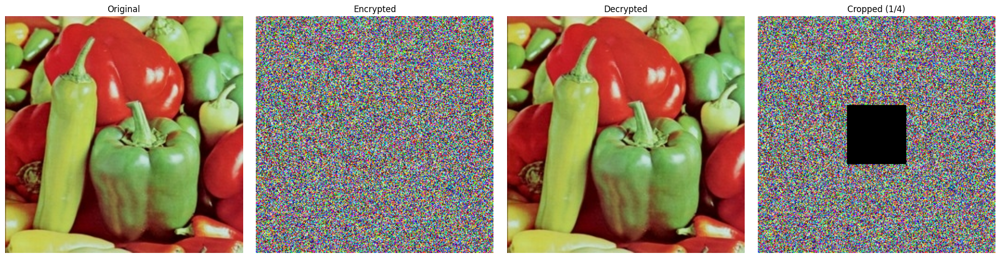

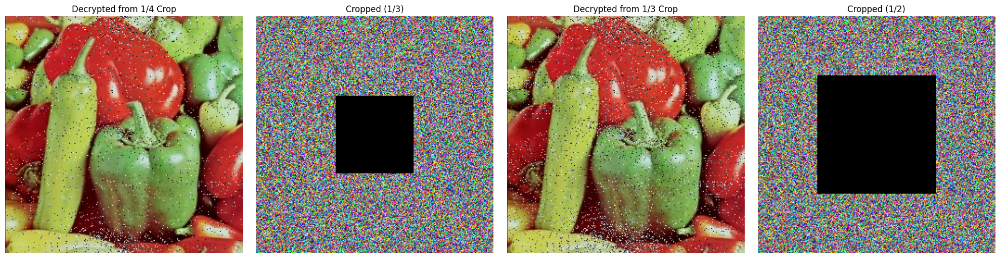

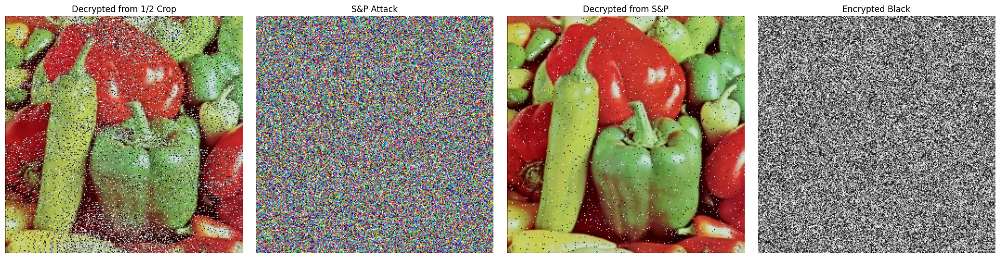

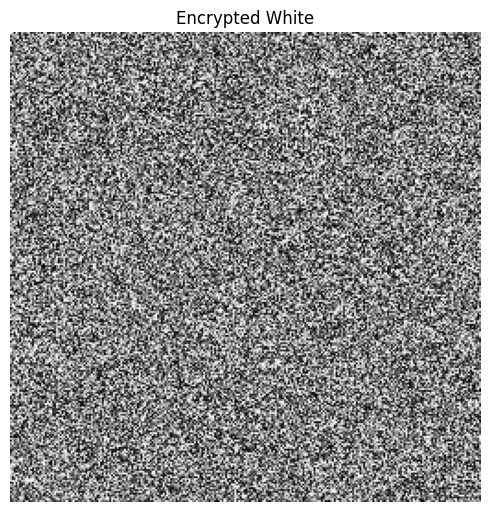

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import struct

# ====================== ENCRYPTION & DECRYPTION ======================

def encrypt(img):
    N = img.shape[0]
    R, G, B = cv2.split(img)

    def standard_map(N, K=0.5, iterations=100):
        theta, p = np.meshgrid(np.linspace(0, 2 * np.pi, N), np.linspace(0, 2 * np.pi, N))
        for _ in range(iterations):
            p = (p + K * np.sin(theta)) % (2 * np.pi)
            theta = (theta + p) % (2 * np.pi)
        sorted_indices = np.argsort(theta.ravel())
        return sorted_indices.reshape(N, N)

    def standard_scramble(channel, N):
        indices = standard_map(N).flatten()
        scrambled = channel.flatten()[indices].reshape(N, N)
        return scrambled, indices.reshape(N, N)

    R_scrambled, R_map = standard_scramble(R, N)
    G_scrambled, G_map = standard_scramble(G, N)
    B_scrambled, B_map = standard_scramble(B, N)

    def logistic_sine_map(n, x0=0.3, y0=0.3, a=0.9):
        x, y = x0, y0
        x_seq, y_seq = [], []
        for _ in range(n):
            x = np.sin(np.pi * a * (y + 3) * x * (1 - x))
            y = np.sin(np.pi * a * (x + 4) * y * (1 - y))
            x_seq.append(x)
            y_seq.append(y)
        return np.array(x_seq), np.array(y_seq)

    def linear_congruential_generator(n, L1_0=3538644446, aL1=27, c1=0, m1=2**52-1,
                                      L2_0=2700000, aL2=37, c2=1, m2=2**32-1):
        L1, L2 = L1_0, L2_0
        sequence_L1, sequence_L2 = [], []
        for _ in range(n):
            L1 = (aL1 * L1 + c1) % m1
            L2 = (aL2 * L2 + c2) % m2
            sequence_L1.append(L1)
            sequence_L2.append(L2)
        return np.array(sequence_L1, dtype=np.uint64), np.array(sequence_L2, dtype=np.uint64)

    N_total = N * N
    L1_seq, L2_seq = linear_congruential_generator(N_total)
    x_seq, y_seq = logistic_sine_map(N_total)
    x_seq_bits = np.array([struct.unpack('Q', struct.pack('d', x))[0] for x in x_seq], dtype=np.uint64)
    y_seq_bits = np.array([struct.unpack('Q', struct.pack('d', y))[0] for y in y_seq], dtype=np.uint64)
    a_bits = np.array(int(0.9 * (2**44)) & ((1 << 44) - 1), dtype=np.uint64)

    key_matrix = np.zeros(N_total, dtype=np.uint64)
    for i in range(N_total):
        key_matrix[i] = ((x_seq_bits[i] & ((1 << 64) - 1)) << (64 + 44)) | \
                        ((y_seq_bits[i] & ((1 << 64) - 1)) << 44) | \
                        (a_bits << 32) | \
                        ((L1_seq[i] & ((1 << 52) - 1)) << 32) | \
                        (L2_seq[i] & ((1 << 32) - 1))
    key_matrix = (key_matrix % 256).astype(np.uint8).reshape(N, N)

    def xor_bitwise_submatrices(channel, key):
        channel_bits = np.unpackbits(channel.astype(np.uint8), axis=1)
        key_bits = np.unpackbits(key.astype(np.uint8), axis=1)
        xor_result = np.bitwise_xor(channel_bits, key_bits)
        return np.packbits(xor_result, axis=1).reshape(channel.shape).astype(np.uint8)

    R_encrypted = xor_bitwise_submatrices(R_scrambled, key_matrix)
    G_encrypted = xor_bitwise_submatrices(G_scrambled, key_matrix)
    B_encrypted = xor_bitwise_submatrices(B_scrambled, key_matrix)

    def lorenz_key_generator(n_bytes, x0=0.1, y0=0.1, z0=0.1, sigma=10, rho=28, beta=8/3, dt=0.01, warmup=1000):
        x, y, z = x0, y0, z0
        key_bytes = []
        for _ in range(warmup):
            dx = sigma * (y - x)
            dy = x * (rho - z) - y
            dz = x * y - beta * z
            x += dx * dt
            y += dy * dt
            z += dz * dt
        while len(key_bytes) < n_bytes:
            dx = sigma * (y - x)
            dy = x * (rho - z) - y
            dz = x * y - beta * z
            x += dx * dt
            y += dy * dt
            z += dz * dt
            val = abs((x + y + z) % 1)
            byte = int(val * 256) % 256
            key_bytes.append(byte)
        return np.array(key_bytes, dtype=np.uint8)

    key2_matrix = lorenz_key_generator(N * N).reshape(N, N)

    R_final_encrypted = xor_bitwise_submatrices(R_encrypted, key2_matrix)
    G_final_encrypted = xor_bitwise_submatrices(G_encrypted, key2_matrix)
    B_final_encrypted = xor_bitwise_submatrices(B_encrypted, key2_matrix)

    final_encrypted_img = cv2.merge([R_final_encrypted, G_final_encrypted, B_final_encrypted])
    return final_encrypted_img, key_matrix, key2_matrix, R_map, G_map, B_map

def decrypt(encrypted_img, key_matrix, key2_matrix, R_map, G_map, B_map):
    R_enc, G_enc, B_enc = cv2.split(encrypted_img)

    def xor_bitwise_submatrices(channel, key):
        channel_bits = np.unpackbits(channel.astype(np.uint8), axis=1)
        key_bits = np.unpackbits(key.astype(np.uint8), axis=1)
        xor_result = np.bitwise_xor(channel_bits, key_bits)
        return np.packbits(xor_result, axis=1).reshape(channel.shape).astype(np.uint8)

    def inverse_scramble(channel, mapping):
        N = channel.shape[0]
        unscrambled = np.empty_like(channel)
        unscrambled.flat[mapping.ravel()] = channel.flat
        return unscrambled

    R_partial = xor_bitwise_submatrices(R_enc, key2_matrix)
    G_partial = xor_bitwise_submatrices(G_enc, key2_matrix)
    B_partial = xor_bitwise_submatrices(B_enc, key2_matrix)

    R_decrypted = xor_bitwise_submatrices(R_partial, key_matrix)
    G_decrypted = xor_bitwise_submatrices(G_partial, key_matrix)
    B_decrypted = xor_bitwise_submatrices(B_partial, key_matrix)

    R_final = inverse_scramble(R_decrypted, R_map)
    G_final = inverse_scramble(G_decrypted, G_map)
    B_final = inverse_scramble(B_decrypted, B_map)

    final_decrypted_img = cv2.merge([R_final, G_final, B_final])
    return final_decrypted_img

# ====================== Calculate the NPCR between two encrypted images ======================
def calculate_npcr(image1, image2):
    # Flatten the images to 1D arrays
    image1_flat = image1.flatten()
    image2_flat = image2.flatten()

    # Count the number of differing pixels
    diff_pixels = np.sum(image1_flat != image2_flat)

    # Calculate NPCR
    npcr = (diff_pixels / image1_flat.size) * 100
    return npcr

# ====================== Calculate the UACI between two encrypted images ======================

def calculate_uaci(image1, image2):
    # Flatten the images to 1D arrays
    image1_flat = image1.flatten()
    image2_flat = image2.flatten()

    # Calculate UACI
    uaci = np.sum(np.abs(image1_flat - image2_flat)) / (255 * image1_flat.size) * 100
    return uaci

# ====================== ATTACK 1: CROPPING ======================

def apply_center_cropping_attack(encrypted_img, crop_ratio=0.25):
    h, w, c = encrypted_img.shape
    crop_h, crop_w = int(h * crop_ratio), int(w * crop_ratio)

    start_h = (h - crop_h) // 2
    start_w = (w - crop_w) // 2

    attacked = encrypted_img.copy()
    attacked[start_h:start_h + crop_h, start_w:start_w + crop_w, :] = 0  # black out center crop
    return attacked

# ====================== ATTACK 2: SALT & PEPPER ======================

def apply_salt_and_pepper_attack(encrypted_img, amount=0.02):
    noisy = encrypted_img.copy()
    h, w, c = encrypted_img.shape
    num_salt = int(amount * h * w)
    num_pepper = int(amount * h * w)

    coords = [np.random.randint(0, i - 1, num_salt) for i in (h, w)]
    noisy[coords[0], coords[1], :] = 255

    coords = [np.random.randint(0, i - 1, num_pepper) for i in (h, w)]
    noisy[coords[0], coords[1], :] = 0

    return noisy

# ====================== ATTACK 3: CHOSEN PLAINTEXT ======================

def chosen_plaintext_attack(shape):
    black_img = np.zeros(shape, dtype=np.uint8)
    white_img = np.ones(shape, dtype=np.uint8) * 255

    encrypted_black, *_ = encrypt(black_img)
    encrypted_white, *_ = encrypt(white_img)

    # Calculate NPCR and UACI between the encrypted images
    npcr = calculate_npcr(encrypted_black, encrypted_white)
    uaci = calculate_uaci(encrypted_black, encrypted_white)

    return encrypted_black, encrypted_white, npcr, uaci

# ====================== VISUALIZATION ======================

def show_images(titles, images):
    # Adjust for 4 images in a row
    cols = 4
    rows = (len(images) + cols - 1) // cols  # Dynamically calculate rows based on the number of images

    plt.figure(figsize=(20, 5 * rows))  # Adjust the figure size dynamically

    for i, (title, img) in enumerate(zip(titles, images), 1):
        plt.subplot(rows, cols, i)  # Adjusted to display in rows and columns
        plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        plt.title(title)
        plt.axis("off")

    plt.tight_layout()
    plt.show()

# ====================== RUN TESTS ======================

def run_all(image_path):
    img = cv2.imread(image_path)
    img = cv2.resize(img, (256, 256))

    enc_img, k1, k2, rmap, gmap, bmap = encrypt(img)
    dec_img = decrypt(enc_img, k1, k2, rmap, gmap, bmap)

    # Cropping at different ratios (1/4, 1/3, 1/2)
    cropped_1_4 = apply_center_cropping_attack(enc_img, crop_ratio=0.25)
    cropped_1_3 = apply_center_cropping_attack(enc_img, crop_ratio=0.33)
    cropped_1_2 = apply_center_cropping_attack(enc_img, crop_ratio=0.5)


    # Decrypting cropped images
    decrypted_crop_1_4 = decrypt(cropped_1_4, k1, k2, rmap, gmap, bmap)
    decrypted_crop_1_3 = decrypt(cropped_1_3, k1, k2, rmap, gmap, bmap)
    decrypted_crop_1_2 = decrypt(cropped_1_2, k1, k2, rmap, gmap, bmap)

    # Salt and Pepper attack
    noisy = apply_salt_and_pepper_attack(enc_img)
    decrypted_noisy = decrypt(noisy, k1, k2, rmap, gmap, bmap)

    # Chosen Plaintext Attack
    encrypted_black, encrypted_white, npcr, uaci = chosen_plaintext_attack(img.shape)

    # Diffusion metric
    print(f"NPCR between black and white encrypted images: {npcr:.2f}%")
    print(f"UACI between black and white encrypted images: {uaci:.2f}%")

    # Show Results
    show_images(
        ["Original", "Encrypted", "Decrypted", "Cropped (1/4)"],
        [img, enc_img, dec_img, cropped_1_4]
    )
    show_images(
        ["Decrypted from 1/4 Crop", "Cropped (1/3)", "Decrypted from 1/3 Crop", "Cropped (1/2)"],
        [decrypted_crop_1_4, cropped_1_3, decrypted_crop_1_3, cropped_1_2]
    )
    show_images(
        ["Decrypted from 1/2 Crop", "S&P Attack", "Decrypted from S&P", "Encrypted Black"],
        [decrypted_crop_1_2, noisy, decrypted_noisy, encrypted_black]
    )
    show_images(
        ["Encrypted White"],
        [encrypted_white]
    )

# === RUN TESTS ===
run_all("/content/image3.jpg")

NPCR after one-bit flip: 0.00%
UACI after one-bit flip: 0.00%


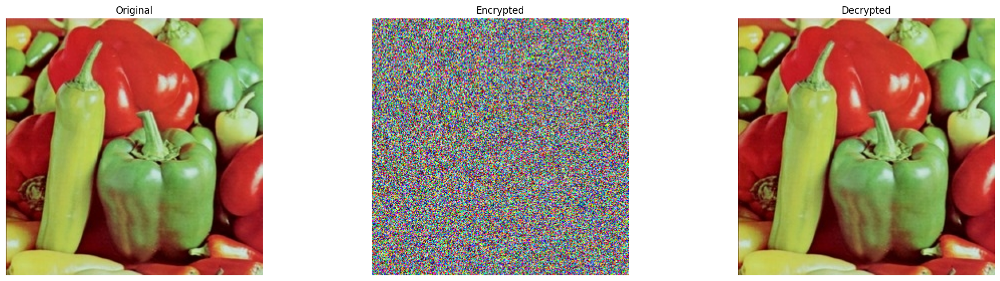

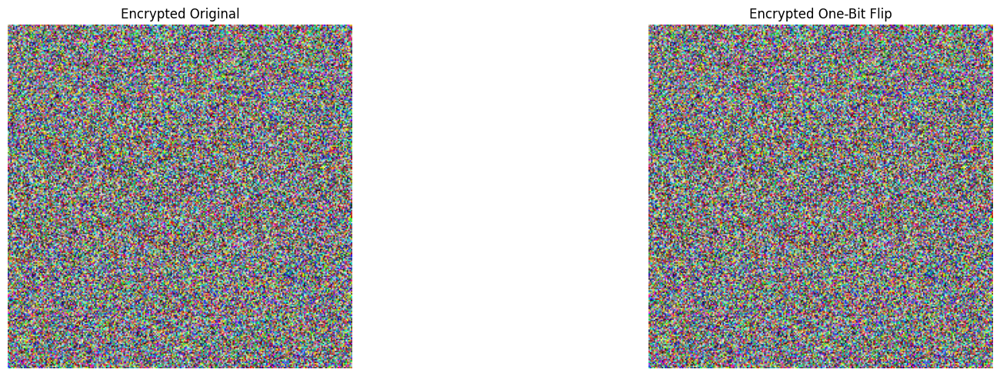

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import struct

# ====================== ENCRYPTION & DECRYPTION ======================

def encrypt(img):
    N = img.shape[0]
    R, G, B = cv2.split(img)

    def standard_map(N, K=0.5, iterations=100):
        theta, p = np.meshgrid(np.linspace(0, 2 * np.pi, N), np.linspace(0, 2 * np.pi, N))
        for _ in range(iterations):
            p = (p + K * np.sin(theta)) % (2 * np.pi)
            theta = (theta + p) % (2 * np.pi)
        sorted_indices = np.argsort(theta.ravel())
        return sorted_indices.reshape(N, N)

    def standard_scramble(channel, N):
        indices = standard_map(N).flatten()
        scrambled = channel.flatten()[indices].reshape(N, N)
        return scrambled, indices.reshape(N, N)

    R_scrambled, R_map = standard_scramble(R, N)
    G_scrambled, G_map = standard_scramble(G, N)
    B_scrambled, B_map = standard_scramble(B, N)

    def logistic_sine_map(n, x0=0.3, y0=0.3, a=0.9):
        x, y = x0, y0
        x_seq, y_seq = [], []
        for _ in range(n):
            x = np.sin(np.pi * a * (y + 3) * x * (1 - x))
            y = np.sin(np.pi * a * (x + 4) * y * (1 - y))
            x_seq.append(x)
            y_seq.append(y)
        return np.array(x_seq), np.array(y_seq)

    def linear_congruential_generator(n, L1_0=3538644446, aL1=27, c1=0, m1=2**52-1,
                                      L2_0=2700000, aL2=37, c2=1, m2=2**32-1):
        L1, L2 = L1_0, L2_0
        sequence_L1, sequence_L2 = [], []
        for _ in range(n):
            L1 = (aL1 * L1 + c1) % m1
            L2 = (aL2 * L2 + c2) % m2
            sequence_L1.append(L1)
            sequence_L2.append(L2)
        return np.array(sequence_L1, dtype=np.uint64), np.array(sequence_L2, dtype=np.uint64)

    N_total = N * N
    L1_seq, L2_seq = linear_congruential_generator(N_total)
    x_seq, y_seq = logistic_sine_map(N_total)
    x_seq_bits = np.array([struct.unpack('Q', struct.pack('d', x))[0] for x in x_seq], dtype=np.uint64)
    y_seq_bits = np.array([struct.unpack('Q', struct.pack('d', y))[0] for y in y_seq], dtype=np.uint64)
    a_bits = np.array(int(0.9 * (2**44)) & ((1 << 44) - 1), dtype=np.uint64)

    key_matrix = np.zeros(N_total, dtype=np.uint64)
    for i in range(N_total):
        key_matrix[i] = ((x_seq_bits[i] & ((1 << 64) - 1)) << (64 + 44)) | \
                        ((y_seq_bits[i] & ((1 << 64) - 1)) << 44) | \
                        (a_bits << 32) | \
                        ((L1_seq[i] & ((1 << 52) - 1)) << 32) | \
                        (L2_seq[i] & ((1 << 32) - 1))
    key_matrix = (key_matrix % 256).astype(np.uint8).reshape(N, N)

    def xor_bitwise_submatrices(channel, key):
        channel_bits = np.unpackbits(channel.astype(np.uint8), axis=1)
        key_bits = np.unpackbits(key.astype(np.uint8), axis=1)
        xor_result = np.bitwise_xor(channel_bits, key_bits)
        return np.packbits(xor_result, axis=1).reshape(channel.shape).astype(np.uint8)

    R_encrypted = xor_bitwise_submatrices(R_scrambled, key_matrix)
    G_encrypted = xor_bitwise_submatrices(G_scrambled, key_matrix)
    B_encrypted = xor_bitwise_submatrices(B_scrambled, key_matrix)

    def lorenz_key_generator(n_bytes, x0=0.1, y0=0.1, z0=0.1, sigma=10, rho=28, beta=8/3, dt=0.01, warmup=1000):
        x, y, z = x0, y0, z0
        key_bytes = []
        for _ in range(warmup):
            dx = sigma * (y - x)
            dy = x * (rho - z) - y
            dz = x * y - beta * z
            x += dx * dt
            y += dy * dt
            z += dz * dt
        while len(key_bytes) < n_bytes:
            dx = sigma * (y - x)
            dy = x * (rho - z) - y
            dz = x * y - beta * z
            x += dx * dt
            y += dy * dt
            z += dz * dt
            val = abs((x + y + z) % 1)
            byte = int(val * 256) % 256
            key_bytes.append(byte)
        return np.array(key_bytes, dtype=np.uint8)

    key2_matrix = lorenz_key_generator(N * N).reshape(N, N)

    R_final_encrypted = xor_bitwise_submatrices(R_encrypted, key2_matrix)
    G_final_encrypted = xor_bitwise_submatrices(G_encrypted, key2_matrix)
    B_final_encrypted = xor_bitwise_submatrices(B_encrypted, key2_matrix)

    final_encrypted_img = cv2.merge([R_final_encrypted, G_final_encrypted, B_final_encrypted])
    return final_encrypted_img, key_matrix, key2_matrix, R_map, G_map, B_map

def decrypt(encrypted_img, key_matrix, key2_matrix, R_map, G_map, B_map):
    R_enc, G_enc, B_enc = cv2.split(encrypted_img)

    def xor_bitwise_submatrices(channel, key):
        channel_bits = np.unpackbits(channel.astype(np.uint8), axis=1)
        key_bits = np.unpackbits(key.astype(np.uint8), axis=1)
        xor_result = np.bitwise_xor(channel_bits, key_bits)
        return np.packbits(xor_result, axis=1).reshape(channel.shape).astype(np.uint8)

    def inverse_scramble(channel, mapping):
        N = channel.shape[0]
        unscrambled = np.empty_like(channel)
        unscrambled.flat[mapping.ravel()] = channel.flat
        return unscrambled

    R_partial = xor_bitwise_submatrices(R_enc, key2_matrix)
    G_partial = xor_bitwise_submatrices(G_enc, key2_matrix)
    B_partial = xor_bitwise_submatrices(B_enc, key2_matrix)

    R_decrypted = xor_bitwise_submatrices(R_partial, key_matrix)
    G_decrypted = xor_bitwise_submatrices(G_partial, key_matrix)
    B_decrypted = xor_bitwise_submatrices(B_partial, key_matrix)

    R_final = inverse_scramble(R_decrypted, R_map)
    G_final = inverse_scramble(G_decrypted, G_map)
    B_final = inverse_scramble(B_decrypted, B_map)

    final_decrypted_img = cv2.merge([R_final, G_final, B_final])
    return final_decrypted_img

# ====================== METRICS ======================

def chosen_plaintext_attack_one_bit_flip(img):
    encrypted_original, *_ = encrypt(img)
    modified_img = img.copy()

    # Flip 1 bit in the first pixel of the R channel (red channel)
    modified_img[0, 0, 2] ^= 0x01  # XOR with 1 to flip the least significant bit

    encrypted_modified, *_ = encrypt(modified_img)

    # Recalculate NPCR and UACI after the bit flip
    npcr = calculate_npcr(encrypted_original, encrypted_modified)
    uaci = calculate_uaci(encrypted_original, encrypted_modified)

    return encrypted_original, encrypted_modified, npcr, uaci

def calculate_npcr(image1, image2):
    # Flatten the images and count the differing pixels
    diff_pixels = np.sum(image1.flatten() != image2.flatten())
    return (diff_pixels / image1.size) * 100

def calculate_uaci(image1, image2):
    # Calculate absolute difference and normalize it
    diff = np.abs(image1.astype(np.int16) - image2.astype(np.int16))
    return np.sum(diff) / (255 * image1.size) * 100

# Visualization and Testing
def run_chosen_plaintext_only(image_path):
    img = cv2.imread(image_path)
    img = cv2.resize(img, (256, 256))

    enc_img, k1, k2, rmap, gmap, bmap = encrypt(img)
    dec_img = decrypt(enc_img, k1, k2, rmap, gmap, bmap)

    enc1, enc2, npcr, uaci = chosen_plaintext_attack_one_bit_flip(img)

    print(f"NPCR after one-bit flip: {npcr:.2f}%")
    print(f"UACI after one-bit flip: {uaci:.2f}%")

    show_images(["Original", "Encrypted", "Decrypted"], [img, enc_img, dec_img])
    show_images(["Encrypted Original", "Encrypted One-Bit Flip"], [enc1, enc2])

# === RUN TEST ===
run_chosen_plaintext_only("/content/image3.jpg")


In [ ]:
unique, counts = np.unique(key1_bits, return_counts=True)
print(dict(zip(unique, counts)))

{np.str_('011000010000011011111110110101101111010101111111011001101101101111000111110001111100101001010111100101101100011010101110001010011111110010001011000110110000011000000010010100101110001010110110010101111001010110101110001011101010101010110010101110110001001111001101101001001011100110111111101011100100011000100111101100101100011111011101111111000111001010001100010110011110101100010111011010000010011001111111011011101111001100101101100011000101001011101111100011111100101001000111010011000000111100111111001110111010000000101001000011001100011111000111111010001001001000100101011111001111100011011111011000001110011001011101100000001001010010000111100001000001101111101010111011000011000000001010100001010100000110000010111010101110101100001010100011101000110001010110100000101110011001100000111110001111110110010010000110111111010001010000101010010111101111011001011101100001001111010111000110000111110100110001001011111101011100101110101011100010111111100111100010001010111001000110000111

In [ ]:
#NIST
from google.colab import files
uploaded = files.upload()


Saving sts-2_1_2.zip to sts-2_1_2.zip


In [ ]:
#Extract zip file
import zipfile
import os

zip_path = "/content/sts-2_1_2.zip"
extract_path = "/content/sts-2_1_2"

with zipfile.ZipFile(zip_path, "r") as zip_ref:
    zip_ref.extractall(extract_path)

print("Extraction complete!")


Extraction complete!


In [ ]:
import os

# List all files in the current directory (after extraction)
extracted_files = os.listdir("/content")
print(extracted_files)

# List files inside the "src" folder where the runTests.py script is expected
os.listdir("/content/sts-2_1_2/sts-2.1.2/sts-2.1.2/src")


['.config', 'key2_bits.txt', 'encrypted_G_channel_bits.txt', 'decrypted.png', 'final_encrypted_image_bits.txt', 'encrypted_B_channel_bits.txt', 'encrypted_B_channel.png', 'original.png', 'encrypted_R_channel.png', 'encrypted_R_channel_bits.txt', 'image2.jpg', 'sts-2_1_2.zip', 'key1_bits.txt', 'encrypted.png', 'sts-2_1_2', 'encrypted_G_channel.png', 'sample_data']


['genutils.c',
 'cephes.c',
 'approximateEntropy.c',
 'runs.c',
 'overlappingTemplateMatchings.c',
 'frequency.c',
 'utilities.c',
 'rank.c',
 'longestRunOfOnes.c',
 'blockFrequency.c',
 'universal.c',
 'generators.c',
 'dfft.c',
 'assess.c',
 'randomExcursions.c',
 'nonOverlappingTemplateMatchings.c',
 'cusum.c',
 'randomExcursionsVariant.c',
 'serial.c',
 'linearComplexity.c',
 'matrix.c',
 'discreteFourierTransform.c']

In [ ]:
#Navigate
%cd /content/sts-2_1_2/sts-2.1.2/sts-2.1.2/src

/content/sts-2_1_2/sts-2.1.2/sts-2.1.2/src


In [ ]:
# Compile all C files into an executable named 'assess'
!gcc -o assess *.c -lm


cc1: fatal error: *.c: No such file or directory
compilation terminated.


In [ ]:
# Install GCC compiler
!apt-get update
!apt-get install gcc
!apt-get install build-essential

Get:1 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2204/x86_64  InRelease [1,581 B]
Get:2 https://cloud.r-project.org/bin/linux/ubuntu jammy-cran40/ InRelease [3,632 B]
Get:3 http://security.ubuntu.com/ubuntu jammy-security InRelease [129 kB]
Hit:4 http://archive.ubuntu.com/ubuntu jammy InRelease
Get:5 https://r2u.stat.illinois.edu/ubuntu jammy InRelease [6,555 B]
Get:6 http://archive.ubuntu.com/ubuntu jammy-updates InRelease [128 kB]
Get:7 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2204/x86_64  Packages [1,383 kB]
Hit:8 https://ppa.launchpadcontent.net/deadsnakes/ppa/ubuntu jammy InRelease
Hit:9 https://ppa.launchpadcontent.net/graphics-drivers/ppa/ubuntu jammy InRelease
Hit:10 https://ppa.launchpadcontent.net/ubuntugis/ppa/ubuntu jammy InRelease
Get:11 http://archive.ubuntu.com/ubuntu jammy-backports InRelease [127 kB]
Get:12 https://r2u.stat.illinois.edu/ubuntu jammy/main amd64 Packages [2,684 kB]
Get:13 https://r2u.stat.illinois.edu/ubuntu jamm

In [ ]:
# Compile C code

#include <math.h>   // For sqrt, erfc
#include <stdio.h>  // For printf, etc.
#include <stdlib.h> // For malloc, free, etc.

!gcc /content/sts-2_1_2/sts-2.1.2/sts-2.1.2/src/*.c -lm -o runs_test


In [ ]:
import numpy as np
import os

# Function to check file existence, size, and read the first few bytes
def check_and_read_bin_file(file_path):
    if os.path.exists(file_path):
        file_size = os.path.getsize(file_path)
        print(f"File '{file_path}' exists with size: {file_size} bytes")

        # Read the file into a NumPy array (binary format)
        binary_data = np.fromfile(file_path, dtype=np.uint8)
        print("First 10 bytes:", binary_data[:10])

        # Check if file is empty
        if file_size == 0:
            print(f"ERROR: The bits file {file_path} is empty")
        return binary_data
    else:
        print(f"ERROR: The bits file {file_path} does not exist")
        return None

# Check for the first key file
key1_bit_path = "/content/sts-2_1_2/sts-2.1.2/sts-2.1.2/data/key1_bits.txt"
check_and_read_bin_file(key1_bit_path)

# Check for the second key file
key2_bit_path = "/content/sts-2_1_2/sts-2.1.2/sts-2.1.2/data/key2_bits.txt"
check_and_read_bin_file(key2_bit_path)


File '/content/sts-2_1_2/sts-2.1.2/sts-2.1.2/data/key1_bits.txt' exists with size: 524288 bytes
First 10 bytes: [48 49 49 48 48 48 48 49 48 48]
File '/content/sts-2_1_2/sts-2.1.2/sts-2.1.2/data/key2_bits.txt' exists with size: 524288 bytes
First 10 bytes: [48 48 48 48 48 48 48 49 48 48]


array([48, 48, 48, ..., 48, 48, 49], dtype=uint8)

In [ ]:
import os

# Check if bitstream file exists and preview first 100 bits
if os.path.exists(bitstream_path):
    print("key1_bits.txt exists!")
    !head -c 100 /content/sts-2_1_2/sts-2.1.2/sts-2.1.2/data/key1_bits.txt
else:
    print("ERROR: key_bitstream.txt is still missing!")


key1_bits.txt exists!
0110000100000110111111101101011011110101011111110110011011011011110001111100011111001010010101111001

In [ ]:
import os

base_path = "/content/sts-2_1_2/sts-2.1.2/sts-2.1.2"
experiment_path = "/content/sts-2_1_2/sts-2.1.2/sts-2.1.2/experiments/AlgorithmTesting"

# Create the required directory structure
#os.makedirs("/content/sts-2_1_2/sts-2.1.2/sts-2.1.2/experiments/AlgorithmTesting", exist_ok=True)

#print("Fixed: Created missing directory structure")

freq_file = os.path.join(experiment_path, "freq.txt")

with open(freq_file, "w") as f:
    f.write("")  # Create an empty file

print("Fixed: freq.txt created")

os.chmod(freq_file, 0o777)  # Adjust the permissions

# Check freq.txt exists

if os.path.exists(freq_file):
    print("freq.txt exists!")
else:
    print("freq.txt is missing!")


Fixed: freq.txt created
freq.txt exists!


In [ ]:
import os

# Directory for freq.txt
freq_file_path = '/content/sts-2_1_2/sts-2.1.2/sts-2.1.2/src/freq.txt'

# Create an empty freq.txt
os.makedirs(os.path.dirname(freq_file_path), exist_ok=True)
with open(freq_file_path, 'w') as f:
    f.write("")  # Write empty content or the necessary data

print("freq.txt has been created!")


freq.txt has been created!


In [ ]:
if os.path.exists(freq_file_path):
    print("freq.txt exists!")
else:
    print("freq.txt is missing!")


freq.txt exists!


In [ ]:
ls -l /content/sts-2_1_2/sts-2.1.2/sts-2.1.2/experiments/AlgorithmTesting/freq.txt


-rwxrwxrwx 1 root root 0 Apr  9 05:34 /content/sts-2_1_2/sts-2.1.2/sts-2.1.2/experiments/AlgorithmTesting/freq.txt*


In [ ]:
# Function to read the bitstream file and return its length
def get_bitstream_length(filepath):
    with open(filepath, "r") as f:
        bitstream = f.read().strip()
    return len(bitstream)

# Filepaths
bitstream_files = {
    "R Channel": "/content/sts-2_1_2/sts-2.1.2/sts-2.1.2/data/encrypted_R_channel_bits.txt",
    "G Channel": "/content/sts-2_1_2/sts-2.1.2/sts-2.1.2/data/encrypted_G_channel_bits.txt",
    "B Channel": "/content/sts-2_1_2/sts-2.1.2/sts-2.1.2/data/encrypted_B_channel_bits.txt",
    "Final Encrypted Image": "/content/sts-2_1_2/sts-2.1.2/sts-2.1.2/data/final_encrypted_image_bits.txt",
    "Key 1": "/content/sts-2_1_2/sts-2.1.2/sts-2.1.2/data/key1_bits.txt",
    "Key 2": "/content/sts-2_1_2/sts-2.1.2/sts-2.1.2/data/key2_bits.txt",
}

# Display lengths
for name, path in bitstream_files.items():
    length = get_bitstream_length(path)
    print(f"{name} Bitstream Length: {length} bits")


R Channel Bitstream Length: 524288 bits
G Channel Bitstream Length: 524288 bits
B Channel Bitstream Length: 524288 bits
Final Encrypted Image Bitstream Length: 1572864 bits
Key 1 Bitstream Length: 524288 bits
Key 2 Bitstream Length: 524288 bits


In [ ]:
# File permissions
!chmod -R 777 /content

!chmod -R 777 /content/sts-2_1_2/sts-2.1.2/sts-2.1.2/experiments/AlgorithmTesting/

In [ ]:
%cd /content/sts-2_1_2/sts-2.1.2/sts-2.1.2/src
# Run test
!./assess 524288

/content/sts-2_1_2/sts-2.1.2/sts-2.1.2/src
           G E N E R A T O R    S E L E C T I O N 
           ______________________________________

    [0] Input File                 [1] Linear Congruential
    [2] Quadratic Congruential I   [3] Quadratic Congruential II
    [4] Cubic Congruential         [5] XOR
    [6] Modular Exponentiation     [7] Blum-Blum-Shub
    [8] Micali-Schnorr             [9] G Using SHA-1

   Enter Choice: 0


		User Prescribed Input File: /content/sts-2_1_2/sts-2.1.2/sts-2.1.2/data/key1_bits.txt

                S T A T I S T I C A L   T E S T S
                _________________________________

    [01] Frequency                       [02] Block Frequency
    [03] Cumulative Sums                 [04] Runs
    [05] Longest Run of Ones             [06] Rank
    [07] Discrete Fourier Transform      [08] Nonperiodic Template Matchings
    [09] Overlapping Template Matchings  [10] Universal Statistical
    [11] Approximate Entropy             [12] Random Excursi